# Training Custom ResNet
___

## Table of contents
1. [Imports](#Imports)
2. [LoadData](#LoadData)
3. [Config](#Configs)
4. [Analysis](#Analysis)
5. [Process](#Process)

## Imports

In [1]:
import os
import numpy as np
import pandas as pd

import optuna
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torch.utils.data import Dataset,DataLoader,random_split
from torch.utils.tensorboard import SummaryWriter
import torchvision
from torchvision import models, transforms
from torch_lr_finder import LRFinder

from tqdm.notebook import tqdm

import math
import pretrainedmodels as ptm
import h5py
import copy
from datetime import datetime
import matplotlib.pyplot as plt

In [2]:
from Library.datasets import DatasetH5TwoRandom, DatasetH5ForTest, compute_std_mean
from Library.transforms import RandomFlip,RandomOffset,RandomRotateGrayscale
from Library.scheduler import OneCycleLR,LogLR
from Library.cresnet import initialize_cresnet
from Library.dml import RefBasedDeepMetric
from Library.models.FeatureExtractor import FeatureExtractor, Block, CustomNet
from Library.trainers import RefBasedDeepMetricTrainer

In [3]:
from Library.util import (
    jupyter_wide_screen,
    strings_contain_words, 
    strings_contain_patterns, 
    add_unique_entry
)

jupyter_wide_screen()

## LoadData

#### To initialize dataset: obtain References and Dataset object

In [4]:
#### To initialize dataset: obtain References and Dataset object
def init_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []
    
    ### 可能还需要用 transforms.RandomHorizontalFlip()  RandomRotate
    #img_transforms = [transforms.ToTensor(),transforms.Normalize((mean_val,),(std_val,))] # 先标准化处理
    img_transforms = [#RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5TwoRandom(h5_fpath,transform = composed_img_transforms)
        
        # obtain the references, the first 10 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [5]:
# 3 stripes
data_path = "../data/22008_1000202026_652510007"
fnames = "roi_versuch2_1_{}_720x20.h5"
combined_path = os.path.join(data_path, fnames)
seq_idx_list = [0,1,2,3,4,5]

In [6]:
inputs_shape = [1,720,20]
batch_sizes = [32, 32, 32]
shuffle_flags = [True, False, False]
ds_ratio = [0.6, 0.2, 0.2]

In [7]:
mean_val = 124.8660
std_val = 67.9694
refs_list, ds_h5 = init_dataset(combined_path, seq_idx_list, mean_val, std_val)

In [8]:
len(refs_list)

6

#### Dataloader for training set ,validation set, test set (60%,20%,20%)

In [9]:
def init_dataloaders(datasets,ds_ratio):
    dataloaders = []
    
    for ds in datasets:
        splitted_ds_num_data = [round(len(ds) * ds_ratio[i]) for i in range(len(ds_ratio))]
        splitted_ds_num_data[0] += len(ds) - int(np.sum(splitted_ds_num_data))

        splitted_ds = []

        for tmp_ds, batch_size, shuffle in zip(random_split(ds, splitted_ds_num_data), batch_sizes, shuffle_flags):

            splitted_ds.append(
                DataLoader(
                    tmp_ds,
                    batch_size=batch_size,
                    shuffle=shuffle,
                    drop_last=True,
                )
            )

        dataloaders.append(splitted_ds)
    return dataloaders

In [10]:
dataloaders = init_dataloaders(ds_h5, ds_ratio)

train_dls = [dls[0] for dls in dataloaders]
valid_dls = [dls[1] for dls in dataloaders]
test_dls = [dls[2] for dls in dataloaders]

## FeatureExtractor

In [4]:
class FeatureExtractor(nn.Module):
    # Custom feature extraction model from pretrained ResNet50

    def __init__(self, model,zero_init_residual=False):
        super(FeatureExtractor, self).__init__()
        
        self.conv1= nn.Conv2d(1, 64, 3, (2,1), 1)
        self.bn1 = model.bn1
        #self.relu = nn.LeakyReLU(inplace = True)
        self.relu = model.relu
        self.maxpool = model.maxpool

        self.layer1 = model.layer1
        self.layer2 = model.layer2

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Sequential(nn.Linear(128, 64))
                
        # weights initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode = 'fan_in', nonlinearity = 'leaky_relu')

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        
        self.featuremap0 = x.detach() # 核心代码

        x = self.layer1(x)
        self.featuremap1 = x.detach() # 核心代码
        
        x = self.layer2(x)
        self.featuremap2 = x.detach() # 核心代码
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)

        x = self.fc(x)
        self.featuremapfc = x.detach() # 核心代码
        
        return x
    
    def show_intermediate_shape(self, x):
    
        x = self.conv1(x)
        print("In conv1: ", x.shape)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        print("In maxpool: ", x.shape)
        x = self.layer1(x)
        print("In layer1: ", x.shape)
        x = self.layer2(x)
        print("In layer2: ", x.shape)
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)
        x = self.fc(x)
        print("In FC: ", x.shape)

## SiameseNet structure

In [ ]:
class SiameseNet(nn.Module):
    def __init__(self, model):
        super(SiameseNet, self).__init__()
        self.model = model
        
    def _calculate_loss(self, v1, v2, refs_tensor):
        r"""Calculate distance between vector of img1&img2 and each reference images

        Args:
            v1 (Tensor, torch.Size[batchsize,128]): batch of img1s from feature extractor
            v2 (Tensor, torch.Size[batchsize,128]): batch of img2s from feature extractor
            refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
        """
        v_dim = v1.size(1)
        num_ref = refs_tensor.size(0)

        v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
        v22 = v2.unsqueeze(1).repeat(1, num_ref, 1)
        refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size

        kernel_matrix1 = (v11-refs).pow(2).sum(2) #torch.Size([batchsize, 10])
        kernel_matrix2 = (v22-refs).pow(2).sum(2) #torch.Size([batchsize, 10])

        v1_distance_mean = torch.mean(kernel_matrix1,dim = 1) #torch.Size([batchsize])
        v2_distance_mean = torch.mean(kernel_matrix2,dim = 1) #torch.Size([batchsize])
        
        diff = v1_distance_mean - v2_distance_mean
        
        #print("Before Sigmoid outputs",outputs)
        sigmoid = nn.Sigmoid()
        outputs = sigmoid(diff)
        #print("After Sigmoid outputs",outputs)

        return outputs

    def forward(self, x1, x2, refs):
        v1 = self.model(x1)
        v2 = self.model(x2)
        feature_refs = self.model(refs)
        
        outputs = self._calculate_loss(v1, v2, feature_refs)
        return outputs
    
    # This function used to plot the degradation metric , x1 is the sequential image
    def forward_test(self, x1, refs):
        v1 = self.model(x1)
        feature_refs = self.model(refs)
        
        return v1, feature_refs
    
    def get_model(self, x):
        return self.model(x)


#### Load pretrained ResNet

In [12]:
res_model = models.resnet34(pretrained=True)
feature_extractor = FeatureExtractor(res_model)
model = RefBasedDeepMetric(feature_extractor,loss_non_linearity_name='sigmoid',criterion_name='bce',)
#model = SiameseNet(feature_extractor)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

RefBasedDeepMetric(
  (feature_extractor): FeatureExtractor(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, aff

In [13]:
inputs = torch.randn(1,1,720,20)
model.feature_extractor.show_intermediate_shape(inputs.to(device))

In conv1:  torch.Size([1, 64, 360, 20])
In maxpool:  torch.Size([1, 64, 180, 10])
In layer1:  torch.Size([1, 64, 180, 10])
In layer2:  torch.Size([1, 128, 90, 5])
In FC:  torch.Size([1, 64])


## Learning Rate Test

In [14]:
from torch.optim.lr_scheduler import _LRScheduler
from torch_lr_finder import LRFinder ,TrainDataLoaderIter, ValDataLoaderIter

In [15]:
class CustomTrainIter(TrainDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels
    
    def __next__(self):
        try:
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)
        except StopIteration:
            if not self.auto_reset:
                raise
            self._iterator = iter(self.data_loader)
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)

        return img1, img2, labels

In [16]:
class CustomValIter(ValDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels

In [17]:
class LinearLR(_LRScheduler):
    """Linearly increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(LinearLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr + r * (self.end_lr - base_lr) for base_lr in self.base_lrs]

In [18]:
class ExponentialLR(_LRScheduler):
    """Exponentially increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(ExponentialLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        # In earlier Pytorch versions last_epoch starts at -1, while in recent versions
        # it starts at 0. We need to adjust the math a bit to handle this. See
        # discussion at: https://github.com/davidtvs/pytorch-lr-finder/pull/42
        
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr * (self.end_lr / base_lr) ** r for base_lr in self.base_lrs]

In [19]:
try:
    from apex import amp

    IS_AMP_AVAILABLE = True
except ImportError:
    IS_AMP_AVAILABLE = False
    
class CustomLRFinder(LRFinder):
    
    def custom_range_test(
        self,
        train_loader,
        curr_refs,
        val_loader=None,
        start_lr=None,
        end_lr=10,
        num_iter=100,
        step_mode="exp",
        smooth_f=0.05,
        diverge_th=5,
        accumulation_steps=1,
        non_blocking_transfer=True,
    ):
       
        # Reset test results
        self.history = {"lr": [], "loss": []}
        self.best_loss = None

        # Move the model to the proper device
        self.model.to(self.device)

        # Check if the optimizer is already attached to a scheduler
        self._check_for_scheduler()

        # Set the starting learning rate
        if start_lr:
            self._set_learning_rate(start_lr)

        # Initialize the proper learning rate policy
        if step_mode.lower() == "exp":
            lr_schedule = ExponentialLR(self.optimizer, end_lr, num_iter)
        elif step_mode.lower() == "linear":
            lr_schedule = LinearLR(self.optimizer, end_lr, num_iter)
        else:
            raise ValueError("expected one of (exp, linear), got {}".format(step_mode))

        if smooth_f < 0 or smooth_f >= 1:
            raise ValueError("smooth_f is outside the range [0, 1[")

        # Create an iterator to get data batch by batch
        if isinstance(train_loader, DataLoader):
            train_iter = TrainDataLoaderIter(train_loader)
        elif isinstance(train_loader, TrainDataLoaderIter):
            train_iter = train_loader
        else:
            raise ValueError(
                "`train_loader` has unsupported type: {}."
                "Expected types are `torch.utils.data.DataLoader`"
                "or child of `TrainDataLoaderIter`.".format(type(train_loader))
            )

        if val_loader:
            if isinstance(val_loader, DataLoader):
                val_iter = CustomValIter(val_loader)
            elif isinstance(val_loader, ValDataLoaderIter):
                val_iter = val_loader
            else:
                raise ValueError(
                    "`val_loader` has unsupported type: {}."
                    "Expected types are `torch.utils.data.DataLoader`"
                    "or child of `ValDataLoaderIter`.".format(type(val_loader))
                )

        for iteration in tqdm(range(num_iter)):
            # Train on batch and retrieve loss
            loss = self._train_batch(
                train_iter,
                curr_refs,
                accumulation_steps,
                non_blocking_transfer= non_blocking_transfer,
            )
            if val_loader:
                loss = self._validate(
                    val_iter, curr_refs, non_blocking_transfer=non_blocking_transfer
                )

            # Update the learning rate
            self.history["lr"].append(lr_schedule.get_lr()[0])
            lr_schedule.step()

            # Track the best loss and smooth it if smooth_f is specified
            if iteration == 0:
                self.best_loss = loss
            else:
                if smooth_f > 0:
                    loss = smooth_f * loss + (1 - smooth_f) * self.history["loss"][-1]
                if loss < self.best_loss:
                    self.best_loss = loss

            # Check if the loss has diverged; if it has, stop the test
            self.history["loss"].append(loss)
            if loss > diverge_th * self.best_loss:
                print("Stopping early, the loss has diverged")
                break

        print("Learning rate search finished. See the graph with {finder_name}.plot()")

    def _train_batch(self, train_iter, curr_refs, accumulation_steps, non_blocking_transfer=True):
        self.model.train()
        total_loss = None  # for late initialization
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.optimizer.zero_grad()
        curr_refs = curr_refs.float().to(device)

        for i in range(accumulation_steps):
            img1, img2, labels = next(train_iter)
            labels = labels.view(-1)
            labels = labels.to(device)
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)

            # Forward pass
            loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)

            # Loss should be averaged in each step
            loss /= accumulation_steps

            # Backward pass
            if IS_AMP_AVAILABLE and hasattr(self.optimizer, "_amp_stash"):
                # For minor performance optimization, see also:
                # https://nvidia.github.io/apex/advanced.html#gradient-accumulation-across-iterations
                delay_unscale = ((i + 1) % accumulation_steps) != 0

                with amp.scale_loss(
                    loss, self.optimizer, delay_unscale=delay_unscale
                ) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if total_loss is None:
                total_loss = loss
            else:
                total_loss += loss

        self.optimizer.step()

        return total_loss.item()
    
    def _validate(self, val_iter, curr_refs, non_blocking_transfer=True):
        # Set model to evaluation mode and disable gradient computation
        running_loss = 0
        self.model.eval()
        
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        curr_refs = curr_refs.float().to(device)
        with torch.no_grad():
            for img1, img2, labels in val_iter:
                # Move data to the correct device
                labels = labels.view(-1)
                labels = labels.to(device)
                img1 = img1.float().to(device)
                img2 = img2.float().to(device)

                # Forward pass and loss computation
                loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)
                running_loss += loss.item() * len(labels)

        return running_loss / len(val_iter.dataset)
    

### LR Test Config

In [20]:
start_lr = 1e-8
end_lr = 1e-1

min_lr_factor   = 0.2
anneal_lr_factor= 1e-1

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2
refs_dl_idx = 0

optimizer = torch.optim.Adam(model.parameters(),lr=start_lr, eps=1e-08, weight_decay=0)
#optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, momentum=0.5)
#criterion = nn.CrossEntropyLoss()
#criterion = nn.BCEWithLogitsLoss(reduction = 'none')
criterion = nn.BCELoss()


Learning rate search finished. See the graph with {finder_name}.plot()


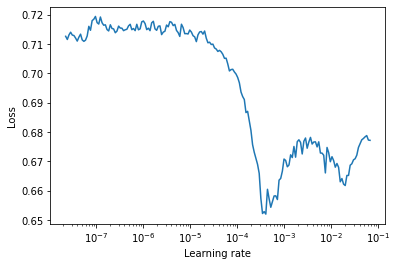

In [22]:
#lr_finder.reset()
lr_finder = CustomLRFinder(model, optimizer, criterion, device="cuda")

# seq dataloader / shuffel the dataloader
for refs, train_dl, val_dl in zip (refs_list, train_dls, valid_dls):
    custom_train_iter = CustomTrainIter(train_dl)
    custom_val_iter = CustomValIter(val_dl)
lr_finder.custom_range_test(custom_train_iter, curr_refs = refs, end_lr=end_lr, num_iter=200)
lr_finder.plot(suggest_lr= False)
lr_finder.reset()

## Training Config

In [23]:
num_epochs = 50

lr = 1e-4

min_lr_factor = 0.1
phases_ratio = [0.3, 0.2, 0.3, 0.2]

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2

run_train = True

net_path = "../MA/save_net/"
criterion = nn.BCELoss()
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']
    
dateTimeObj = datetime.now()
timestampStr = dateTimeObj.strftime("%d-%b-%Y (%H:%M:%S)")
print('Current Timestamp : ', timestampStr)

Current Timestamp :  22-May-2021 (21:34:20)


Total Train Iterations:  580
Total Train Iterations List:  [37, 82, 209, 291, 476, 580]
Valid iterations per seq:  [12, 15, 42, 28, 61, 35]


Train



Sequence:1, Seq Training Mean Loss: 0.702329023464306, Seq Training Acc: 0.4814189189189189
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.685880700747172, Seq Training Acc: 0.5298611111111111
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6953406479414992, Seq Training Acc: 0.5172244094488189
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6951209219490609, Seq Training Acc: 0.5179115853658537
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6787644428175849, Seq Training Acc: 0.5706081081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.6481326543367826, Seq Training Acc: 0.6274038461538461
******************************************************************
Epoch:1, Epoch Training Loss Mean: 0.6812692880630493, Epoch Training Acc: 0.552801724137931
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.740541676680247, Seq Valid Acc: 0.5



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6248935500780741, Seq Valid Acc: 0.6729166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7907046306700933, Seq Valid Acc: 0.44494047619047616



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7023820004292897, Seq Valid Acc: 0.5234375



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6678092723987141, Seq Valid Acc: 0.6116803278688525



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.5684732053961072, Seq Valid Acc: 0.7151785714285714
Epoch:1, Epoch Valid Mean Loss: 0.6827415227890015, Epoch Valid Acc: 0.5791774611398963
******************************************************************


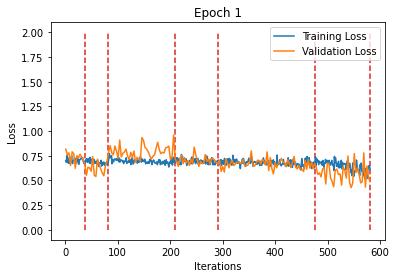

Train



Sequence:1, Seq Training Mean Loss: 0.7028430184802493, Seq Training Acc: 0.5320945945945946
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.6020648784107632, Seq Training Acc: 0.7034722222222223
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6865886276162515, Seq Training Acc: 0.5524114173228346
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6945174598112339, Seq Training Acc: 0.5137195121951219
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6567117127212319, Seq Training Acc: 0.6158783783783783
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.5543522957998973, Seq Training Acc: 0.7259615384615384
******************************************************************
Epoch:2, Epoch Training Loss Mean: 0.6489475965499878, Epoch Training Acc: 0.608728448275862
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.8263736764589945, Seq Valid Acc: 0.4166666666666667



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5780235052108764, Seq Valid Acc: 0.6770833333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7854967486290705, Seq Valid Acc: 0.49404761904761907



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7211752363613674, Seq Valid Acc: 0.5089285714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6811700443752476, Seq Valid Acc: 0.6039959016393442



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.5186924627849034, Seq Valid Acc: 0.7491071428571429
Epoch:2, Epoch Valid Mean Loss: 0.68122398853302, Epoch Valid Acc: 0.5866256476683938
******************************************************************


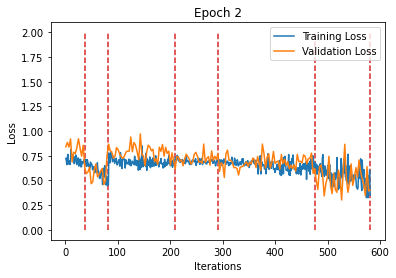

Train



Sequence:1, Seq Training Mean Loss: 0.68554144453358, Seq Training Acc: 0.5785472972972973
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.48548350003030566, Seq Training Acc: 0.7638888888888888
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.680149150645639, Seq Training Acc: 0.5738188976377953
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6900803621222333, Seq Training Acc: 0.5579268292682927
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.652123583974065, Seq Training Acc: 0.6199324324324325
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.53013705705794, Seq Training Acc: 0.734375
******************************************************************
Epoch:3, Epoch Training Loss Mean: 0.6309559345245361, Epoch Training Acc: 0.6301185344827587
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7438338746627172, Seq Valid Acc: 0.4817708333333333



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5895044922828674, Seq Valid Acc: 0.725



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7573136942727225, Seq Valid Acc: 0.4880952380952381



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.698518767952919, Seq Valid Acc: 0.5569196428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6635289358311012, Seq Valid Acc: 0.6029713114754098



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.46374896253858294, Seq Valid Acc: 0.7901785714285714
Epoch:3, Epoch Valid Mean Loss: 0.6520246863365173, Epoch Valid Acc: 0.6071891191709845
******************************************************************


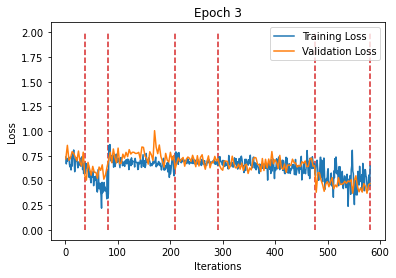

Train



Sequence:1, Seq Training Mean Loss: 0.6914978510624653, Seq Training Acc: 0.5405405405405406
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4663420836130778, Seq Training Acc: 0.78125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6812600268153693, Seq Training Acc: 0.5649606299212598
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6863298328911386, Seq Training Acc: 0.5495426829268293
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6390029918503117, Seq Training Acc: 0.6361486486486486
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.4833173564133736, Seq Training Acc: 0.7653245192307693
******************************************************************
Epoch:4, Epoch Training Loss Mean: 0.6169835329055786, Epoch Training Acc: 0.6366379310344827
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.8100501249233881, Seq Valid Acc: 0.4427083333333333



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6027488271395366, Seq Valid Acc: 0.66875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7146751000767663, Seq Valid Acc: 0.5126488095238095



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.701076118009431, Seq Valid Acc: 0.5535714285714286



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6529322862625122, Seq Valid Acc: 0.617827868852459



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.4647382651056562, Seq Valid Acc: 0.7839285714285714
Epoch:4, Epoch Valid Mean Loss: 0.6450934410095215, Epoch Valid Acc: 0.6088082901554405
******************************************************************


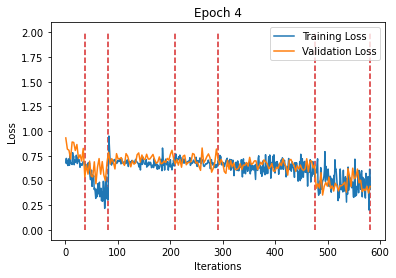

Train



Sequence:1, Seq Training Mean Loss: 0.6842857599258423, Seq Training Acc: 0.5548986486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.41811941431628336, Seq Training Acc: 0.8076388888888889
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6801403634191499, Seq Training Acc: 0.5819389763779528
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6691677330470667, Seq Training Acc: 0.5826981707317073
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6273008915218147, Seq Training Acc: 0.6508445945945946
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.47687145265249103, Seq Training Acc: 0.7683293269230769
******************************************************************
Epoch:5, Epoch Training Loss Mean: 0.6052221059799194, Epoch Training Acc: 0.6532327586206896
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.711109017332395, Seq Valid Acc: 0.5416666666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5637687484423319, Seq Valid Acc: 0.74375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7228877416678837, Seq Valid Acc: 0.5074404761904762



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6838176846504211, Seq Valid Acc: 0.5825892857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6591632151212848, Seq Valid Acc: 0.6137295081967213



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.4996572766985212, Seq Valid Acc: 0.7660714285714286
Epoch:5, Epoch Valid Mean Loss: 0.6434972882270813, Epoch Valid Acc: 0.6193329015544041
******************************************************************


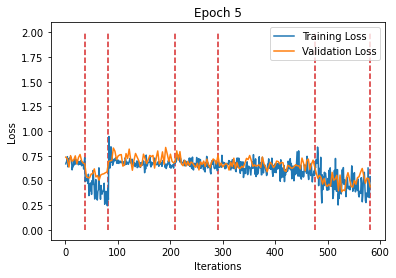

Train



Sequence:1, Seq Training Mean Loss: 0.6870216582272504, Seq Training Acc: 0.5405405405405406
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.42671093510256874, Seq Training Acc: 0.8048611111111111
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6847632292687423, Seq Training Acc: 0.5649606299212598
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6672764013453227, Seq Training Acc: 0.5907012195121951
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.6083982042364172, Seq Training Acc: 0.6743243243243243
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.48650471751506513, Seq Training Acc: 0.7749399038461539
******************************************************************
Epoch:6, Epoch Training Loss Mean: 0.6025061011314392, Epoch Training Acc: 0.6581896551724138
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7012661298116049, Seq Valid Acc: 0.5546875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6289538820584615, Seq Valid Acc: 0.6854166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7358548513480595, Seq Valid Acc: 0.49330357142857145



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.7137657084635326, Seq Valid Acc: 0.5457589285714286



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6574478256897848, Seq Valid Acc: 0.6142418032786885



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.4549922398158482, Seq Valid Acc: 0.7901785714285714
Epoch:6, Epoch Valid Mean Loss: 0.646476149559021, Epoch Valid Acc: 0.6117227979274611
******************************************************************


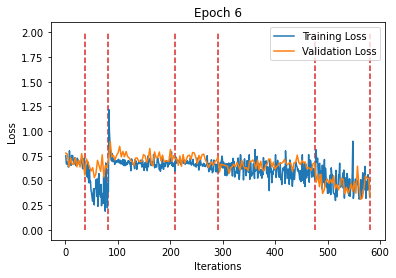

Train



Sequence:1, Seq Training Mean Loss: 0.6902282608521951, Seq Training Acc: 0.5616554054054054
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4294411410888036, Seq Training Acc: 0.8166666666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6804762102487519, Seq Training Acc: 0.577755905511811
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6571018448690089, Seq Training Acc: 0.6147103658536586
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5931425131656028, Seq Training Acc: 0.6802364864864865
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.4333770928474573, Seq Training Acc: 0.8010817307692307
******************************************************************
Epoch:7, Epoch Training Loss Mean: 0.5861529111862183, Epoch Training Acc: 0.6732219827586207
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7130322555700938, Seq Valid Acc: 0.5208333333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6049228946367899, Seq Valid Acc: 0.6895833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.714797134910311, Seq Valid Acc: 0.5401785714285714



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6930102088621685, Seq Valid Acc: 0.5647321428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6564742746900339, Seq Valid Acc: 0.6296106557377049



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.45757947606699806, Seq Valid Acc: 0.7910714285714285
Epoch:7, Epoch Valid Mean Loss: 0.6379078030586243, Epoch Valid Acc: 0.6279145077720207
******************************************************************


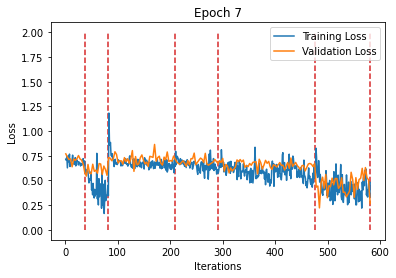

Train



Sequence:1, Seq Training Mean Loss: 0.6758121058747575, Seq Training Acc: 0.5717905405405406
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.441066355837716, Seq Training Acc: 0.8
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6769430534107479, Seq Training Acc: 0.5775098425196851
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6310831729958697, Seq Training Acc: 0.6543445121951219
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5850077677417446, Seq Training Acc: 0.700168918918919
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.4105580271436618, Seq Training Acc: 0.8170072115384616
******************************************************************
Epoch:8, Epoch Training Loss Mean: 0.5749967098236084, Epoch Training Acc: 0.6873383620689655
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.717060312628746, Seq Valid Acc: 0.515625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6210473497708638, Seq Valid Acc: 0.6354166666666666



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7474900342169262, Seq Valid Acc: 0.48660714285714285



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.724291205406189, Seq Valid Acc: 0.5669642857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6430486733796167, Seq Valid Acc: 0.6424180327868853



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3903902121952602, Seq Valid Acc: 0.8428571428571429
Epoch:8, Epoch Valid Mean Loss: 0.6346362233161926, Epoch Valid Acc: 0.6254857512953368
******************************************************************


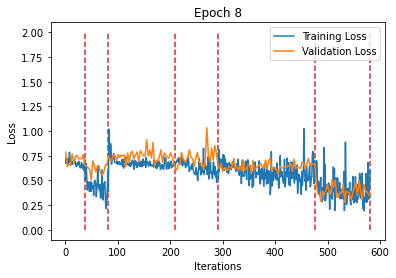

Train



Sequence:1, Seq Training Mean Loss: 0.6811597798321698, Seq Training Acc: 0.5768581081081081
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4650579243898392, Seq Training Acc: 0.7791666666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.655379975874593, Seq Training Acc: 0.6158956692913385
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.6128632309960156, Seq Training Acc: 0.6646341463414634
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.5473149935941438, Seq Training Acc: 0.7268581081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.40326952647704345, Seq Training Acc: 0.8146033653846154
******************************************************************
Epoch:9, Epoch Training Loss Mean: 0.5565721988677979, Epoch Training Acc: 0.7039870689655172
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7061731219291687, Seq Valid Acc: 0.5338541666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5563388148943583, Seq Valid Acc: 0.73125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7203960418701172, Seq Valid Acc: 0.5111607142857143



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6928449741431645, Seq Valid Acc: 0.5569196428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6669585313953337, Seq Valid Acc: 0.6070696721311475



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3794153107064111, Seq Valid Acc: 0.8241071428571428
Epoch:9, Epoch Valid Mean Loss: 0.6240386366844177, Epoch Valid Acc: 0.623380829015544
******************************************************************


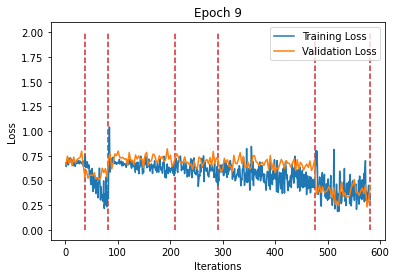

Train



Sequence:1, Seq Training Mean Loss: 0.6741952010103174, Seq Training Acc: 0.5886824324324325
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3765385217136807, Seq Training Acc: 0.8305555555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6479377821674497, Seq Training Acc: 0.6240157480314961
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5575653252805152, Seq Training Acc: 0.711890243902439
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.533878017277331, Seq Training Acc: 0.7415540540540541
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3949209028998247, Seq Training Acc: 0.8173076923076923
******************************************************************
Epoch:10, Epoch Training Loss Mean: 0.5340295433998108, Epoch Training Acc: 0.7223599137931035
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6981827368338903, Seq Valid Acc: 0.5260416666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5559590597947438, Seq Valid Acc: 0.7479166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.732310584613255, Seq Valid Acc: 0.46651785714285715



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6657273875815528, Seq Valid Acc: 0.6395089285714286



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6437460516319901, Seq Valid Acc: 0.6501024590163934



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.45432466651712144, Seq Valid Acc: 0.7848214285714286
Epoch:10, Epoch Valid Mean Loss: 0.6284189820289612, Epoch Valid Acc: 0.6329339378238342
******************************************************************


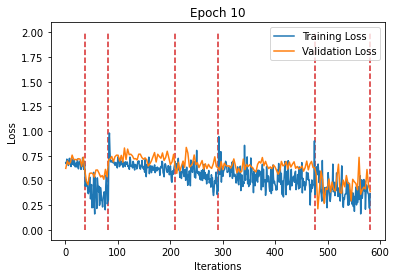

Train



Sequence:1, Seq Training Mean Loss: 0.6659529225246327, Seq Training Acc: 0.5802364864864865
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4131239374478658, Seq Training Acc: 0.8083333333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6299992865464819, Seq Training Acc: 0.6496062992125984
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5321567247553569, Seq Training Acc: 0.7313262195121951
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.49956512451171875, Seq Training Acc: 0.7572635135135135
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.35286835495095986, Seq Training Acc: 0.8326322115384616
******************************************************************
Epoch:11, Epoch Training Loss Mean: 0.5103369951248169, Epoch Training Acc: 0.7362068965517241
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7100886106491089, Seq Valid Acc: 0.5286458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5760675191879272, Seq Valid Acc: 0.7229166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7149218462762379, Seq Valid Acc: 0.5342261904761905



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6768736860581807, Seq Valid Acc: 0.6116071428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6236724804659359, Seq Valid Acc: 0.6670081967213115



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3363631503922599, Seq Valid Acc: 0.85625
Epoch:11, Epoch Valid Mean Loss: 0.6008186340332031, Epoch Valid Acc: 0.6601360103626943
******************************************************************


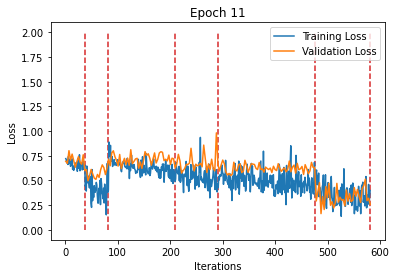

Train



Sequence:1, Seq Training Mean Loss: 0.651894612892254, Seq Training Acc: 0.6224662162162162
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4002179354429245, Seq Training Acc: 0.8090277777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6001732708431604, Seq Training Acc: 0.6766732283464567
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.5034428311557304, Seq Training Acc: 0.7454268292682927
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.48159596613935524, Seq Training Acc: 0.7733108108108108
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3545489006031018, Seq Training Acc: 0.8311298076923077
******************************************************************
Epoch:12, Epoch Training Loss Mean: 0.49241816997528076, Epoch Training Acc: 0.7517241379310344
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6931578467289606, Seq Valid Acc: 0.5416666666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5527730107307434, Seq Valid Acc: 0.7583333333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6981213319869268, Seq Valid Acc: 0.5424107142857143



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6417865071977887, Seq Valid Acc: 0.6674107142857143



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.618813112133839, Seq Valid Acc: 0.6823770491803278



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3521028480359486, Seq Valid Acc: 0.8607142857142858
Epoch:12, Epoch Valid Mean Loss: 0.5905275344848633, Epoch Valid Acc: 0.6792422279792746
******************************************************************


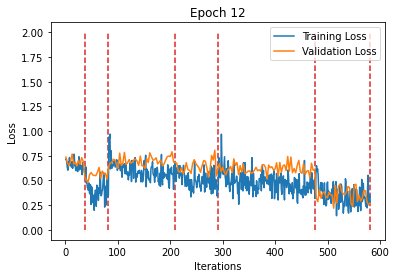

Train



Sequence:1, Seq Training Mean Loss: 0.6280775553471333, Seq Training Acc: 0.6427364864864865
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4051912827624215, Seq Training Acc: 0.8173611111111111
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.6029027625331729, Seq Training Acc: 0.6759350393700787
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.507129382069518, Seq Training Acc: 0.7461890243902439
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.43724813404920937, Seq Training Acc: 0.7959459459459459
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.35410675764656985, Seq Training Acc: 0.8323317307692307
******************************************************************
Epoch:13, Epoch Training Loss Mean: 0.47817888855934143, Epoch Training Acc: 0.7610452586206896
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6714919110139211, Seq Valid Acc: 0.5911458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.552898480494817, Seq Valid Acc: 0.75



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7105376592704228, Seq Valid Acc: 0.5238095238095238



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6584639506680625, Seq Valid Acc: 0.6662946428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6273424029350281, Seq Valid Acc: 0.6721311475409836



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3222272736685617, Seq Valid Acc: 0.8732142857142857
Epoch:13, Epoch Valid Mean Loss: 0.5915895700454712, Epoch Valid Acc: 0.6764896373056994
******************************************************************


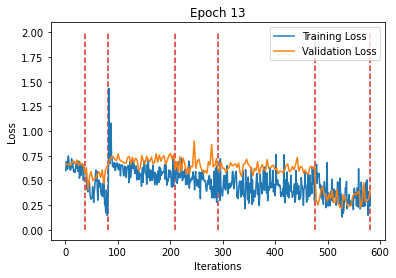

Train



Sequence:1, Seq Training Mean Loss: 0.6132970645621016, Seq Training Acc: 0.6782094594594594
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.38902515835232204, Seq Training Acc: 0.8152777777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5477975710170475, Seq Training Acc: 0.7231791338582677
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.48764757630301686, Seq Training Acc: 0.7610518292682927
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.4293639212846756, Seq Training Acc: 0.799831081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.34864662415706194, Seq Training Acc: 0.8374399038461539
******************************************************************
Epoch:14, Epoch Training Loss Mean: 0.45766738057136536, Epoch Training Acc: 0.7777478448275862
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6866447428862253, Seq Valid Acc: 0.5130208333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5681814471880595, Seq Valid Acc: 0.7520833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6984603291466123, Seq Valid Acc: 0.5424107142857143



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6600831576756069, Seq Valid Acc: 0.6529017857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6185021976955601, Seq Valid Acc: 0.6890368852459017



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.38625441363879615, Seq Valid Acc: 0.8607142857142858
Epoch:14, Epoch Valid Mean Loss: 0.6001432538032532, Epoch Valid Acc: 0.6769753886010362
******************************************************************


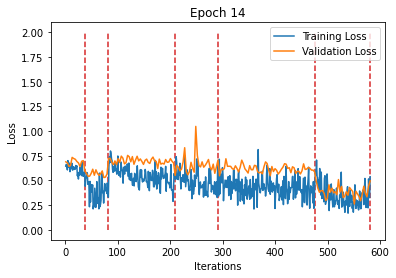

Train



Sequence:1, Seq Training Mean Loss: 0.5903494076148884, Seq Training Acc: 0.7162162162162162
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.37718822028901844, Seq Training Acc: 0.8194444444444444
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.5370332380448739, Seq Training Acc: 0.7386811023622047
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4745387602143171, Seq Training Acc: 0.770579268292683
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.40715997589601055, Seq Training Acc: 0.8094594594594594
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.32214582654146046, Seq Training Acc: 0.8587740384615384
******************************************************************
Epoch:15, Epoch Training Loss Mean: 0.43924060463905334, Epoch Training Acc: 0.7921336206896552
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6433718105157217, Seq Valid Acc: 0.6640625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5586552321910858, Seq Valid Acc: 0.75625



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6808309271222069, Seq Valid Acc: 0.5721726190476191



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6365164369344711, Seq Valid Acc: 0.6830357142857143



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6145748212689259, Seq Valid Acc: 0.6941598360655737



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3293433074440275, Seq Valid Acc: 0.8857142857142857
Epoch:15, Epoch Valid Mean Loss: 0.577894926071167, Epoch Valid Acc: 0.7036917098445595
******************************************************************


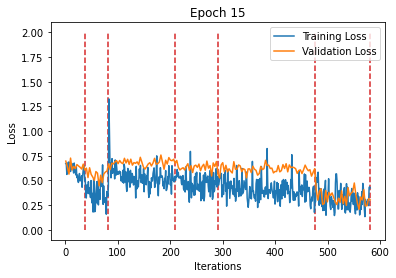

Train



Sequence:1, Seq Training Mean Loss: 0.533899747842067, Seq Training Acc: 0.7356418918918919
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3490085158083174, Seq Training Acc: 0.8479166666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.507864847896606, Seq Training Acc: 0.7576279527559056
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.45865417689811894, Seq Training Acc: 0.7789634146341463
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3981333895309551, Seq Training Acc: 0.8175675675675675
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3230701770203618, Seq Training Acc: 0.8551682692307693
******************************************************************
Epoch:16, Epoch Training Loss Mean: 0.42210710048675537, Epoch Training Acc: 0.8028556034482759
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6184457540512085, Seq Valid Acc: 0.6666666666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5393874804178874, Seq Valid Acc: 0.7479166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6548010281154087, Seq Valid Acc: 0.6153273809523809



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5973395673292023, Seq Valid Acc: 0.7399553571428571



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.576544673227873, Seq Valid Acc: 0.7090163934426229



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.32829267169748033, Seq Valid Acc: 0.8660714285714286
Epoch:16, Epoch Valid Mean Loss: 0.5512890219688416, Epoch Valid Acc: 0.7219883419689119
******************************************************************


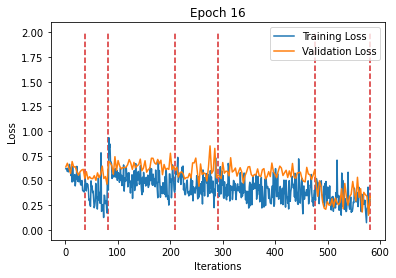

Train



Sequence:1, Seq Training Mean Loss: 0.4646099467535277, Seq Training Acc: 0.7871621621621622
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3321064879496892, Seq Training Acc: 0.85
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.48948647093585157, Seq Training Acc: 0.7650098425196851
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4457124273588018, Seq Training Acc: 0.790015243902439
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38951938023438326, Seq Training Acc: 0.8206081081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3129298184067011, Seq Training Acc: 0.8680889423076923
******************************************************************
Epoch:17, Epoch Training Loss Mean: 0.4059557616710663, Epoch Training Acc: 0.8127693965517241
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5495007038116455, Seq Valid Acc: 0.7760416666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.44097185134887695, Seq Valid Acc: 0.7958333333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6971438725789388, Seq Valid Acc: 0.5870535714285714



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5850783533283642, Seq Valid Acc: 0.7053571428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6059488952159882, Seq Valid Acc: 0.6685450819672131



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3922608418124063, Seq Valid Acc: 0.8205357142857143
Epoch:17, Epoch Valid Mean Loss: 0.5676831007003784, Epoch Valid Acc: 0.7002914507772021
******************************************************************


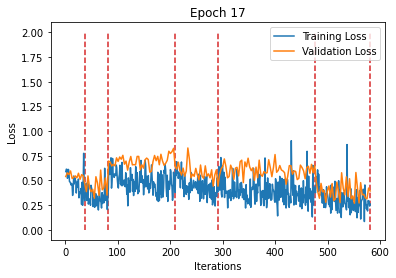

Train



Sequence:1, Seq Training Mean Loss: 0.4229598903172725, Seq Training Acc: 0.8184121621621622
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.350731172826555, Seq Training Acc: 0.8291666666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.47314799324734, Seq Training Acc: 0.765501968503937
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.43590287682486745, Seq Training Acc: 0.7953506097560976
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.37136951942701596, Seq Training Acc: 0.8337837837837838
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.32181933593864626, Seq Training Acc: 0.8500600961538461
******************************************************************
Epoch:18, Epoch Training Loss Mean: 0.3955841660499573, Epoch Training Acc: 0.8149784482758621
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5775896459817886, Seq Valid Acc: 0.7239583333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.566292933622996, Seq Valid Acc: 0.7479166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6553759560698554, Seq Valid Acc: 0.6019345238095238



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5283916997058051, Seq Valid Acc: 0.7578125



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.44809581803493814, Seq Valid Acc: 0.8073770491803278



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.34919664348874774, Seq Valid Acc: 0.8785714285714286
Epoch:18, Epoch Valid Mean Loss: 0.5041552186012268, Epoch Valid Acc: 0.7585816062176166
******************************************************************


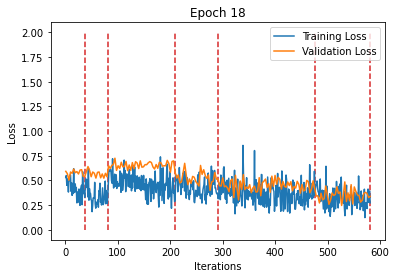

Train



Sequence:1, Seq Training Mean Loss: 0.42918577266706004, Seq Training Acc: 0.7972972972972973
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.33206810967789757, Seq Training Acc: 0.8506944444444444
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.45648737263491773, Seq Training Acc: 0.7770669291338582
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.42167648273270303, Seq Training Acc: 0.7991615853658537
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.38807963261733186, Seq Training Acc: 0.8221283783783784
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.3153495609473724, Seq Training Acc: 0.8611778846153846
******************************************************************
Epoch:19, Epoch Training Loss Mean: 0.39304378628730774, Epoch Training Acc: 0.8166487068965518
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5543622622887293, Seq Valid Acc: 0.7734375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5537780563036601, Seq Valid Acc: 0.75



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6516454631373996, Seq Valid Acc: 0.6183035714285714



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5748708375862667, Seq Valid Acc: 0.7377232142857143



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5430008646894674, Seq Valid Acc: 0.7525614754098361



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.32207508555480413, Seq Valid Acc: 0.8732142857142857
Epoch:19, Epoch Valid Mean Loss: 0.5327471494674683, Epoch Valid Acc: 0.7441709844559585
******************************************************************


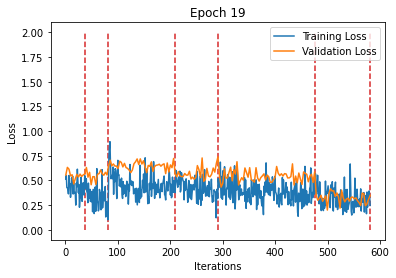

Train



Sequence:1, Seq Training Mean Loss: 0.42128830262132594, Seq Training Acc: 0.7922297297297297
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.33028897013929154, Seq Training Acc: 0.8555555555555555
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4386449141765204, Seq Training Acc: 0.7955216535433071
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4048615712218168, Seq Training Acc: 0.8067835365853658
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3600907703509202, Seq Training Acc: 0.8381756756756756
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2968936594059834, Seq Training Acc: 0.8674879807692307
******************************************************************
Epoch:20, Epoch Training Loss Mean: 0.37388095259666443, Epoch Training Acc: 0.8280711206896552
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5674241185188293, Seq Valid Acc: 0.7161458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.49507853587468464, Seq Valid Acc: 0.7729166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6721289725530715, Seq Valid Acc: 0.5967261904761905



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.590056024491787, Seq Valid Acc: 0.7232142857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.49172065297111134, Seq Valid Acc: 0.8032786885245902



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.25328615137508936, Seq Valid Acc: 0.8919642857142858
Epoch:20, Epoch Valid Mean Loss: 0.5069752931594849, Epoch Valid Acc: 0.7550194300518135
******************************************************************


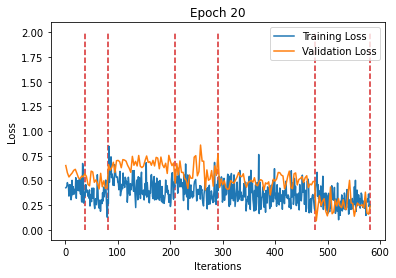

Train



Sequence:1, Seq Training Mean Loss: 0.3772248130392384, Seq Training Acc: 0.8327702702702703
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.32809241314729054, Seq Training Acc: 0.8520833333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.41846385516050294, Seq Training Acc: 0.8001968503937008
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.4159827246898558, Seq Training Acc: 0.7964939024390244
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3497862282637003, Seq Training Acc: 0.8422297297297298
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.27970710224830186, Seq Training Acc: 0.8798076923076923
******************************************************************
Epoch:21, Epoch Training Loss Mean: 0.3616844117641449, Epoch Training Acc: 0.8334590517241379
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5501971493164698, Seq Valid Acc: 0.75



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.47661739389101665, Seq Valid Acc: 0.83125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6545317087854657, Seq Valid Acc: 0.6197916666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5793499127030373, Seq Valid Acc: 0.7354910714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.546782205339338, Seq Valid Acc: 0.7489754098360656



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.34680637674672266, Seq Valid Acc: 0.8758928571428571
Epoch:21, Epoch Valid Mean Loss: 0.5334491729736328, Epoch Valid Acc: 0.748380829015544
******************************************************************


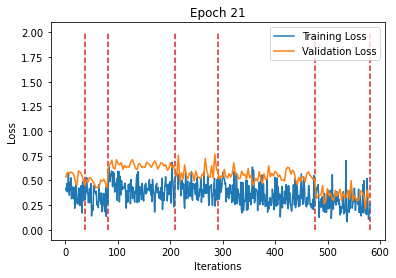

Train



Sequence:1, Seq Training Mean Loss: 0.3866998597576812, Seq Training Acc: 0.831081081081081
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.33886991176340314, Seq Training Acc: 0.8395833333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.42604742557045044, Seq Training Acc: 0.7935531496062992
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.38984718918800354, Seq Training Acc: 0.8216463414634146
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3426851752642039, Seq Training Acc: 0.8439189189189189
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2724729164216954, Seq Training Acc: 0.8692908653846154
******************************************************************
Epoch:22, Epoch Training Loss Mean: 0.3575283885002136, Epoch Training Acc: 0.833135775862069
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.45130659143129986, Seq Valid Acc: 0.8203125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.47348182598749794, Seq Valid Acc: 0.8104166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6452496349811554, Seq Valid Acc: 0.6190476190476191



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.588192846093859, Seq Valid Acc: 0.6997767857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.540883400401131, Seq Valid Acc: 0.7371926229508197



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3206458896398544, Seq Valid Acc: 0.86875
Epoch:22, Epoch Valid Mean Loss: 0.5197113156318665, Epoch Valid Acc: 0.740770725388601
******************************************************************


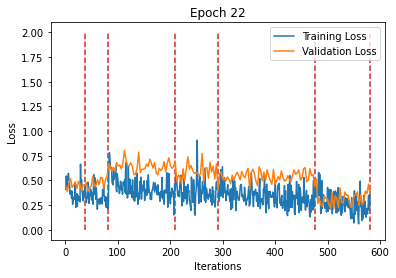

Train



Sequence:1, Seq Training Mean Loss: 0.34125952865626363, Seq Training Acc: 0.8513513513513513
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3399376177125507, Seq Training Acc: 0.8430555555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4231258550966818, Seq Training Acc: 0.7923228346456693
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.39614473119741533, Seq Training Acc: 0.8086890243902439
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3368560720134426, Seq Training Acc: 0.8483108108108108
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2648938217988381, Seq Training Acc: 0.8825120192307693
******************************************************************
Epoch:23, Epoch Training Loss Mean: 0.35174480080604553, Epoch Training Acc: 0.8363685344827586
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5253921325008074, Seq Valid Acc: 0.7786458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4248373051484426, Seq Valid Acc: 0.8166666666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7148454714389074, Seq Valid Acc: 0.5736607142857143



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6414476611784526, Seq Valid Acc: 0.6897321428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5429853494050073, Seq Valid Acc: 0.7305327868852459



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.41856015494891574, Seq Valid Acc: 0.8008928571428572
Epoch:23, Epoch Valid Mean Loss: 0.561829149723053, Epoch Valid Acc: 0.7129209844559585
******************************************************************


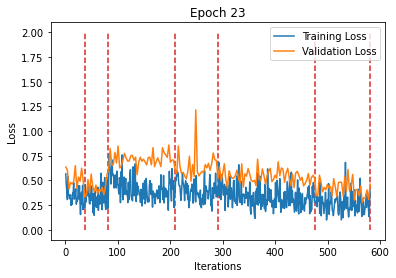

Train



Sequence:1, Seq Training Mean Loss: 0.34065524549097626, Seq Training Acc: 0.8496621621621622
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.32950991789499917, Seq Training Acc: 0.85625
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.39245502263542237, Seq Training Acc: 0.8110236220472441
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.39370201691621687, Seq Training Acc: 0.8083079268292683
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3405201044437048, Seq Training Acc: 0.8494932432432433
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2625446788106973, Seq Training Acc: 0.8852163461538461
******************************************************************
Epoch:24, Epoch Training Loss Mean: 0.3445834517478943, Epoch Training Acc: 0.8421875
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.38962724804878235, Seq Valid Acc: 0.859375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5016553064187368, Seq Valid Acc: 0.7708333333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6233510531130291, Seq Valid Acc: 0.6644345238095238



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.562404103577137, Seq Valid Acc: 0.7321428571428571



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.4214462975009543, Seq Valid Acc: 0.8145491803278688



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.31872240134647917, Seq Valid Acc: 0.8767857142857143
Epoch:24, Epoch Valid Mean Loss: 0.47146075963974, Epoch Valid Acc: 0.7806023316062176
******************************************************************


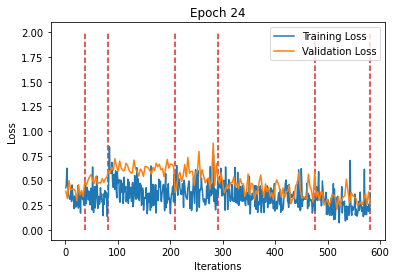

Train



Sequence:1, Seq Training Mean Loss: 0.31282772526547714, Seq Training Acc: 0.8614864864864865
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3308956997262107, Seq Training Acc: 0.8631944444444445
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4028205252069188, Seq Training Acc: 0.8107775590551181
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3799322843551636, Seq Training Acc: 0.8178353658536586
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.33332775960097444, Seq Training Acc: 0.847804054054054
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.26563788814326894, Seq Training Acc: 0.8870192307692307
******************************************************************
Epoch:25, Epoch Training Loss Mean: 0.3414992392063141, Epoch Training Acc: 0.8445581896551724
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.473951796690623, Seq Valid Acc: 0.796875



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4610118945439657, Seq Valid Acc: 0.7875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6477496652376085, Seq Valid Acc: 0.6309523809523809



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6438794444714274, Seq Valid Acc: 0.6886160714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5164301165791808, Seq Valid Acc: 0.7556352459016393



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.23470704044614518, Seq Valid Acc: 0.9035714285714286
Epoch:25, Epoch Valid Mean Loss: 0.5054595470428467, Epoch Valid Acc: 0.7506476683937824
******************************************************************


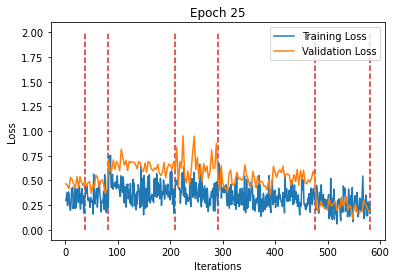

Train



Sequence:1, Seq Training Mean Loss: 0.3141490861370757, Seq Training Acc: 0.8589527027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3032531413767073, Seq Training Acc: 0.8618055555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.38950810200116764, Seq Training Acc: 0.8164370078740157
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3851790737088134, Seq Training Acc: 0.8208841463414634
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3187612991075258, Seq Training Acc: 0.8547297297297297
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2641494434613448, Seq Training Acc: 0.8713942307692307
******************************************************************
Epoch:26, Epoch Training Loss Mean: 0.33235257863998413, Epoch Training Acc: 0.8453663793103449
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3814624299605687, Seq Valid Acc: 0.8489583333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4172081490357717, Seq Valid Acc: 0.81875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6798011263211569, Seq Valid Acc: 0.59375



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6256392630083221, Seq Valid Acc: 0.7120535714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5991295087532919, Seq Valid Acc: 0.7064549180327869



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3288215198687145, Seq Valid Acc: 0.8669642857142857
Epoch:26, Epoch Valid Mean Loss: 0.5438387393951416, Epoch Valid Acc: 0.7294365284974094
******************************************************************


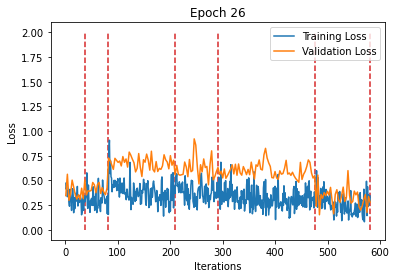

Train



Sequence:1, Seq Training Mean Loss: 0.29623308093161194, Seq Training Acc: 0.8851351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3095126993126339, Seq Training Acc: 0.8638888888888889
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.37547918579240486, Seq Training Acc: 0.8233267716535433
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.38374559653968343, Seq Training Acc: 0.8220274390243902
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.3102358414514645, Seq Training Acc: 0.8555743243243243
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2582016181773864, Seq Training Acc: 0.8873197115384616
******************************************************************
Epoch:27, Epoch Training Loss Mean: 0.32463499903678894, Epoch Training Acc: 0.8519935344827586
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4683685873945554, Seq Valid Acc: 0.8098958333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4687025854984919, Seq Valid Acc: 0.7770833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6772101244756153, Seq Valid Acc: 0.6019345238095238



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6574926440204892, Seq Valid Acc: 0.6595982142857143



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.6382915108907418, Seq Valid Acc: 0.670594262295082



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.4294285101549966, Seq Valid Acc: 0.80625
Epoch:27, Epoch Valid Mean Loss: 0.5879241228103638, Epoch Valid Acc: 0.6955958549222798
******************************************************************


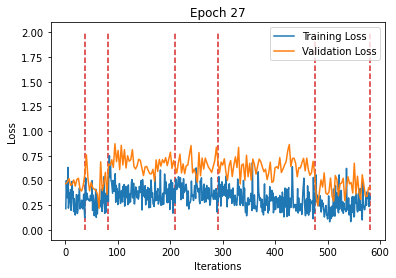

Train



Sequence:1, Seq Training Mean Loss: 0.31441811089580124, Seq Training Acc: 0.856418918918919
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3453171879053116, Seq Training Acc: 0.8284722222222223
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.36784315390849676, Seq Training Acc: 0.8262795275590551
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3549979730713658, Seq Training Acc: 0.833079268292683
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.31535257391027505, Seq Training Acc: 0.8570945945945946
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.23404634901537344, Seq Training Acc: 0.8933293269230769
******************************************************************
Epoch:28, Epoch Training Loss Mean: 0.3201374113559723, Epoch Training Acc: 0.8511853448275862
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.41691988706588745, Seq Valid Acc: 0.8255208333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4392491499582926, Seq Valid Acc: 0.8270833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6681951625006539, Seq Valid Acc: 0.6227678571428571



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6606613610471997, Seq Valid Acc: 0.7020089285714286



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5514365981836788, Seq Valid Acc: 0.7269467213114754



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.24890395998954773, Seq Valid Acc: 0.9026785714285714
Epoch:28, Epoch Valid Mean Loss: 0.5207449197769165, Epoch Valid Acc: 0.7464378238341969
******************************************************************


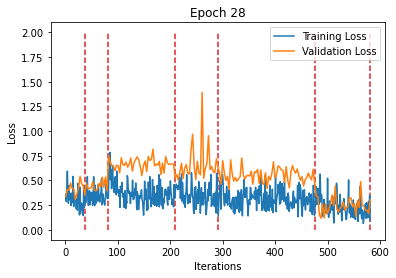

Train



Sequence:1, Seq Training Mean Loss: 0.32283047566542755, Seq Training Acc: 0.8521959459459459
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.31201302144262527, Seq Training Acc: 0.8527777777777777
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3575545118784341, Seq Training Acc: 0.8292322834645669
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.35633646115297224, Seq Training Acc: 0.8422256097560976
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.30362740138898026, Seq Training Acc: 0.8621621621621621
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.22323868581308767, Seq Training Acc: 0.8987379807692307
******************************************************************
Epoch:29, Epoch Training Loss Mean: 0.31034865975379944, Epoch Training Acc: 0.8573275862068965
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.40005338688691455, Seq Valid Acc: 0.8307291666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.39506948987642926, Seq Valid Acc: 0.8166666666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.7315426397891271, Seq Valid Acc: 0.5751488095238095



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6249206864408084, Seq Valid Acc: 0.6997767857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5365415337632914, Seq Valid Acc: 0.7423155737704918



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3281231731176376, Seq Valid Acc: 0.8616071428571429
Epoch:29, Epoch Valid Mean Loss: 0.534521222114563, Epoch Valid Acc: 0.7326748704663213
******************************************************************


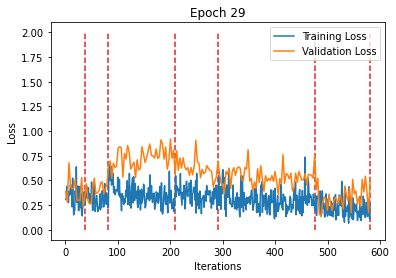

Train



Sequence:1, Seq Training Mean Loss: 0.2743365601510615, Seq Training Acc: 0.8775337837837838
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.31005351841449735, Seq Training Acc: 0.8673611111111111
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3599546135175885, Seq Training Acc: 0.827263779527559
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3520185376812772, Seq Training Acc: 0.8292682926829268
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.31334089866361103, Seq Training Acc: 0.8599662162162162
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2238741832283827, Seq Training Acc: 0.9044471153846154
******************************************************************
Epoch:30, Epoch Training Loss Mean: 0.3102303743362427, Epoch Training Acc: 0.858135775862069
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3863724395632744, Seq Valid Acc: 0.8333333333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3672487686077754, Seq Valid Acc: 0.8354166666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6584664214225042, Seq Valid Acc: 0.6108630952380952



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.626709310071809, Seq Valid Acc: 0.7165178571428571



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.4747803934284898, Seq Valid Acc: 0.7889344262295082



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2417608591062682, Seq Valid Acc: 0.9017857142857143
Epoch:30, Epoch Valid Mean Loss: 0.4806833267211914, Epoch Valid Acc: 0.7665155440414507
******************************************************************


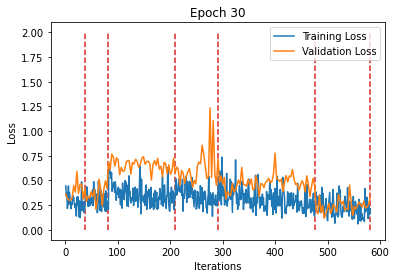

Train



Sequence:1, Seq Training Mean Loss: 0.292234368420936, Seq Training Acc: 0.8665540540540541
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.310958241754108, Seq Training Acc: 0.8652777777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3418380433884193, Seq Training Acc: 0.8403051181102362
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3415186557827926, Seq Training Acc: 0.8391768292682927
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2974764575023909, Seq Training Acc: 0.8643581081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2221307599057372, Seq Training Acc: 0.9050480769230769
******************************************************************
Epoch:31, Epoch Training Loss Mean: 0.30061808228492737, Epoch Training Acc: 0.8630387931034482
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3978339110811551, Seq Valid Acc: 0.8567708333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3910465578238169, Seq Valid Acc: 0.8458333333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6110617291359675, Seq Valid Acc: 0.6636904761904762



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5788246797663825, Seq Valid Acc: 0.7131696428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.46019971956972217, Seq Valid Acc: 0.7930327868852459



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2566520188535963, Seq Valid Acc: 0.8982142857142857
Epoch:31, Epoch Valid Mean Loss: 0.4640745520591736, Epoch Valid Acc: 0.780440414507772
******************************************************************


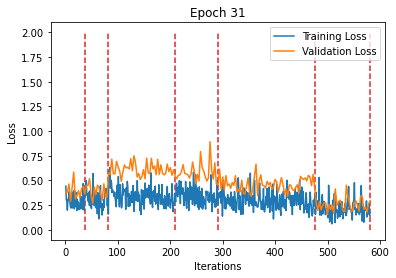

Train



Sequence:1, Seq Training Mean Loss: 0.2967708646445661, Seq Training Acc: 0.8673986486486487
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.26849228673511083, Seq Training Acc: 0.8770833333333333
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3494043696349061, Seq Training Acc: 0.8363681102362205
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3373461265752955, Seq Training Acc: 0.8445121951219512
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2812045789248235, Seq Training Acc: 0.8787162162162162
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.19910264258774427, Seq Training Acc: 0.9131610576923077
******************************************************************
Epoch:32, Epoch Training Loss Mean: 0.2893601953983307, Epoch Training Acc: 0.8699353448275862
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.35633868475755054, Seq Valid Acc: 0.8203125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3677689294020335, Seq Valid Acc: 0.8520833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6437601958002362, Seq Valid Acc: 0.640625



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6046555734106472, Seq Valid Acc: 0.6953125



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.49367783792683334, Seq Valid Acc: 0.7817622950819673



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.20414374960320336, Seq Valid Acc: 0.9169642857142857
Epoch:32, Epoch Valid Mean Loss: 0.47160759568214417, Epoch Valid Acc: 0.7708873056994818
******************************************************************


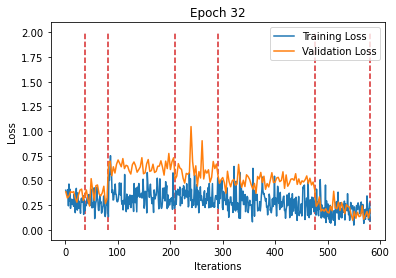

Train



Sequence:1, Seq Training Mean Loss: 0.2664539691161465, Seq Training Acc: 0.8775337837837838
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2917455557319853, Seq Training Acc: 0.8618055555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.33136428740080887, Seq Training Acc: 0.8486712598425197
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3254128758136819, Seq Training Acc: 0.8456554878048781
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.29087723106951324, Seq Training Acc: 0.8724662162162162
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.2162783889171596, Seq Training Acc: 0.9026442307692307
******************************************************************
Epoch:33, Epoch Training Loss Mean: 0.2897581160068512, Epoch Training Acc: 0.8683728448275863
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3867213974396388, Seq Valid Acc: 0.8255208333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3894441882769267, Seq Valid Acc: 0.8333333333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6391607579730806, Seq Valid Acc: 0.6540178571428571



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6587594194071633, Seq Valid Acc: 0.6763392857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5936067602673515, Seq Valid Acc: 0.6977459016393442



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.21508054988724845, Seq Valid Acc: 0.9285714285714286
Epoch:33, Epoch Valid Mean Loss: 0.5155966877937317, Epoch Valid Acc: 0.7454663212435233
******************************************************************


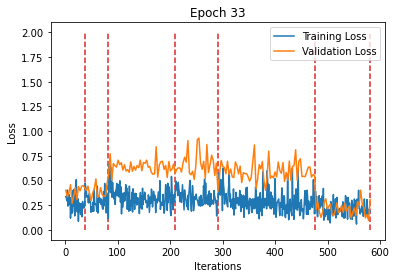

Train



Sequence:1, Seq Training Mean Loss: 0.3107390367501491, Seq Training Acc: 0.870777027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.30478113889694214, Seq Training Acc: 0.8694444444444445
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.33625217873280444, Seq Training Acc: 0.8447342519685039
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.34823053557334877, Seq Training Acc: 0.838795731707317
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2743949087890419, Seq Training Acc: 0.8773648648648649
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.19734239449294713, Seq Training Acc: 0.9122596153846154
******************************************************************
Epoch:34, Epoch Training Loss Mean: 0.2892380952835083, Epoch Training Acc: 0.869989224137931
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3696879843870799, Seq Valid Acc: 0.8411458333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3523454745610555, Seq Valid Acc: 0.85



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5931550988129207, Seq Valid Acc: 0.6808035714285714



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6373427233525685, Seq Valid Acc: 0.7008928571428571



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.46541239394516243, Seq Valid Acc: 0.7986680327868853



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.23500232185636247, Seq Valid Acc: 0.9017857142857143
Epoch:34, Epoch Valid Mean Loss: 0.46163102984428406, Epoch Valid Acc: 0.7841645077720207
******************************************************************


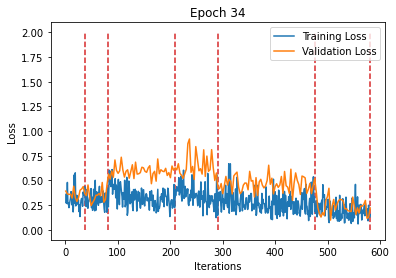

Train



Sequence:1, Seq Training Mean Loss: 0.2711197103600244, Seq Training Acc: 0.8859797297297297
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2811621096399095, Seq Training Acc: 0.8736111111111111
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3220677843948049, Seq Training Acc: 0.8535925196850394
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.33981618194318397, Seq Training Acc: 0.8380335365853658
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2943957280468296, Seq Training Acc: 0.8704391891891892
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.20824432060516512, Seq Training Acc: 0.9086538461538461
******************************************************************
Epoch:35, Epoch Training Loss Mean: 0.28891700506210327, Epoch Training Acc: 0.8702586206896552
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.40291014313697815, Seq Valid Acc: 0.8203125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3665060043334961, Seq Valid Acc: 0.8645833333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6509872320152464, Seq Valid Acc: 0.6264880952380952



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6574734119432313, Seq Valid Acc: 0.6796875



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5532480722568074, Seq Valid Acc: 0.71875



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2677455919129508, Seq Valid Acc: 0.8875
Epoch:35, Epoch Valid Mean Loss: 0.5140023827552795, Epoch Valid Acc: 0.7412564766839378
******************************************************************


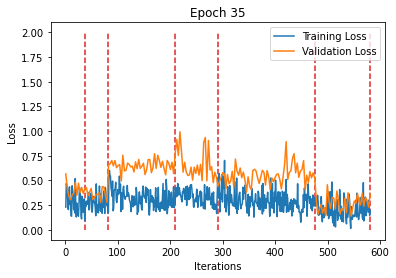

Train



Sequence:1, Seq Training Mean Loss: 0.26107981539255865, Seq Training Acc: 0.8826013513513513
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2761206477880478, Seq Training Acc: 0.8659722222222223
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.33037814497947693, Seq Training Acc: 0.8457185039370079
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3487109082137666, Seq Training Acc: 0.8277439024390244
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.26696041137785526, Seq Training Acc: 0.8797297297297297
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.20068402165690294, Seq Training Acc: 0.9113581730769231
******************************************************************
Epoch:36, Epoch Training Loss Mean: 0.28085607290267944, Epoch Training Acc: 0.8697198275862069
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.32278600335121155, Seq Valid Acc: 0.8828125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.36682111422220864, Seq Valid Acc: 0.8520833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6226190229256948, Seq Valid Acc: 0.6569940476190477



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6084552747862679, Seq Valid Acc: 0.6930803571428571



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.48181206281067895, Seq Valid Acc: 0.7679303278688525



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.27444439785821095, Seq Valid Acc: 0.88125
Epoch:36, Epoch Valid Mean Loss: 0.4743967652320862, Epoch Valid Acc: 0.7671632124352331
******************************************************************


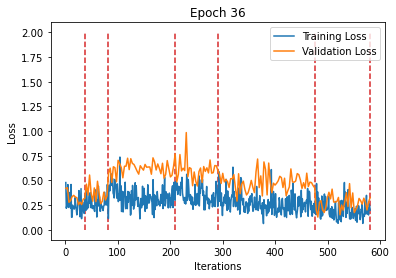

Train



Sequence:1, Seq Training Mean Loss: 0.26565429366923665, Seq Training Acc: 0.8741554054054054
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2691305102573501, Seq Training Acc: 0.8756944444444444
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.30777852776951675, Seq Training Acc: 0.859251968503937
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3363566022457146, Seq Training Acc: 0.8483231707317073
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2660542512664924, Seq Training Acc: 0.8849662162162162
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.20738736006359643, Seq Training Acc: 0.91015625
******************************************************************
Epoch:37, Epoch Training Loss Mean: 0.27482330799102783, Epoch Training Acc: 0.8772629310344827
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.39158520102500916, Seq Valid Acc: 0.8151041666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.38795440991719565, Seq Valid Acc: 0.8291666666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6065035263697306, Seq Valid Acc: 0.6785714285714286



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6152072846889496, Seq Valid Acc: 0.703125



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.4520551283828548, Seq Valid Acc: 0.7986680327868853



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2401393922311919, Seq Valid Acc: 0.8901785714285714
Epoch:37, Epoch Valid Mean Loss: 0.46216338872909546, Epoch Valid Acc: 0.7786593264248705
******************************************************************


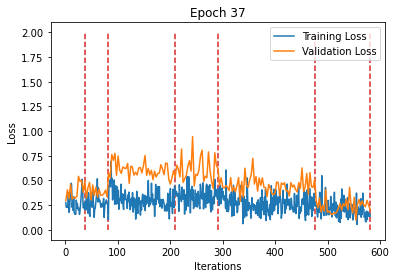

Train



Sequence:1, Seq Training Mean Loss: 0.2722680894909678, Seq Training Acc: 0.8690878378378378
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.25511624134249156, Seq Training Acc: 0.8930555555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.32464541312981776, Seq Training Acc: 0.8499015748031497
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.31589400059566264, Seq Training Acc: 0.8574695121951219
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.27330776988654526, Seq Training Acc: 0.8773648648648649
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.19508596448800886, Seq Training Acc: 0.9107572115384616
******************************************************************
Epoch:38, Epoch Training Loss Mean: 0.2750660479068756, Epoch Training Acc: 0.8752155172413794
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3533889874815941, Seq Valid Acc: 0.859375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3977963825066884, Seq Valid Acc: 0.8041666666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5982522042024703, Seq Valid Acc: 0.6845238095238095



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5882894109402385, Seq Valid Acc: 0.7120535714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.4769473750083173, Seq Valid Acc: 0.7868852459016393



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.3003807502133506, Seq Valid Acc: 0.8580357142857142
Epoch:38, Epoch Valid Mean Loss: 0.4736446738243103, Epoch Valid Acc: 0.7725064766839378
******************************************************************


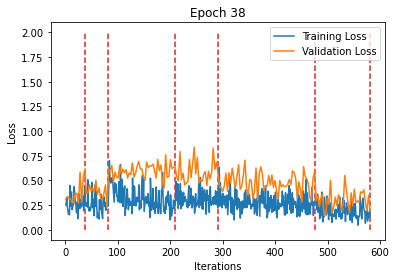

Train



Sequence:1, Seq Training Mean Loss: 0.2555046633288667, Seq Training Acc: 0.8902027027027027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24290048993296093, Seq Training Acc: 0.9027777777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3191087180235255, Seq Training Acc: 0.8516240157480315
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.32409532041084477, Seq Training Acc: 0.8475609756097561
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.28034500302495186, Seq Training Acc: 0.8765202702702702
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.18479674069497448, Seq Training Acc: 0.921875
******************************************************************
Epoch:39, Epoch Training Loss Mean: 0.27339571714401245, Epoch Training Acc: 0.8780172413793104
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3510335311293602, Seq Valid Acc: 0.8619791666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4294299145539602, Seq Valid Acc: 0.8125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5771635337954476, Seq Valid Acc: 0.7127976190476191



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.6249901662979808, Seq Valid Acc: 0.6919642857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.5055054186797533, Seq Valid Acc: 0.7587090163934426



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.17559937228049552, Seq Valid Acc: 0.9303571428571429
Epoch:39, Epoch Valid Mean Loss: 0.46308937668800354, Epoch Valid Acc: 0.7807642487046632
******************************************************************


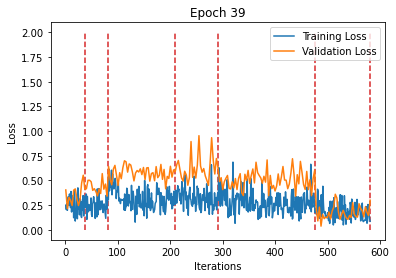

Train



Sequence:1, Seq Training Mean Loss: 0.2492058188528628, Seq Training Acc: 0.8918918918918919
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.26198840919468136, Seq Training Acc: 0.8868055555555555
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.306024172174649, Seq Training Acc: 0.8622047244094488
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3018840071631641, Seq Training Acc: 0.8567073170731707
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.25729533715828046, Seq Training Acc: 0.8886824324324324
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1810284751968888, Seq Training Acc: 0.9233774038461539
******************************************************************
Epoch:40, Epoch Training Loss Mean: 0.2604418396949768, Epoch Training Acc: 0.8846443965517241
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2996998292704423, Seq Valid Acc: 0.890625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.36609626611073814, Seq Valid Acc: 0.84375



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.6335186333883376, Seq Valid Acc: 0.6659226190476191



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5860306152275631, Seq Valid Acc: 0.7265625



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.4878081215209648, Seq Valid Acc: 0.7581967213114754



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2513169710125242, Seq Valid Acc: 0.8875
Epoch:40, Epoch Valid Mean Loss: 0.46972471475601196, Epoch Valid Acc: 0.7718588082901554
******************************************************************


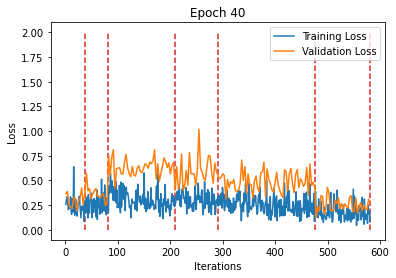

Train



Sequence:1, Seq Training Mean Loss: 0.24786497290069992, Seq Training Acc: 0.8994932432432432
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2687836994727453, Seq Training Acc: 0.8715277777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2890673886955254, Seq Training Acc: 0.8658956692913385
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.31326575559086917, Seq Training Acc: 0.8528963414634146
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.25937661210427415, Seq Training Acc: 0.8834459459459459
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.178824139938045, Seq Training Acc: 0.9215745192307693
******************************************************************
Epoch:41, Epoch Training Loss Mean: 0.2590482831001282, Epoch Training Acc: 0.8822198275862069
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3320898811022441, Seq Valid Acc: 0.8541666666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3967514276504517, Seq Valid Acc: 0.8083333333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5913281916152864, Seq Valid Acc: 0.6889880952380952



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5512052593486649, Seq Valid Acc: 0.734375



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.37904870705526383, Seq Valid Acc: 0.8406762295081968



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2247374964611871, Seq Valid Acc: 0.9133928571428571
Epoch:41, Epoch Valid Mean Loss: 0.4206925630569458, Epoch Valid Acc: 0.8037564766839378
******************************************************************


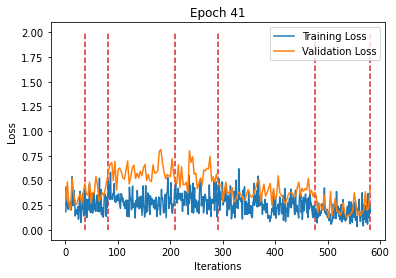

Train



Sequence:1, Seq Training Mean Loss: 0.26328634148513946, Seq Training Acc: 0.8842905405405406
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2759042027923796, Seq Training Acc: 0.8791666666666667
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.299575988701948, Seq Training Acc: 0.8626968503937008
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.29661600182696085, Seq Training Acc: 0.8639481707317073
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2676797102834727, Seq Training Acc: 0.8831081081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.17790034055136716, Seq Training Acc: 0.9230769230769231
******************************************************************
Epoch:42, Epoch Training Loss Mean: 0.2630143463611603, Epoch Training Acc: 0.8828663793103448
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.34473653013507527, Seq Valid Acc: 0.8645833333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4028577208518982, Seq Valid Acc: 0.8125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5835976820616495, Seq Valid Acc: 0.6867559523809523



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5067218361156327, Seq Valid Acc: 0.7522321428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.3756424735804073, Seq Valid Acc: 0.8355532786885246



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2206081081713949, Seq Valid Acc: 0.9080357142857143
Epoch:42, Epoch Valid Mean Loss: 0.4119921922683716, Epoch Valid Acc: 0.8042422279792746
******************************************************************


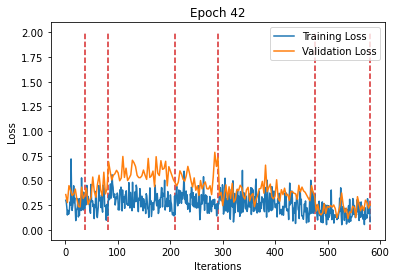

Train



Sequence:1, Seq Training Mean Loss: 0.2861093629050899, Seq Training Acc: 0.8631756756756757
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2913680038518376, Seq Training Acc: 0.86875
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.307756261034744, Seq Training Acc: 0.8587598425196851
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3367676556837268, Seq Training Acc: 0.8376524390243902
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2619883023403786, Seq Training Acc: 0.883277027027027
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.18132660924815214, Seq Training Acc: 0.9224759615384616
******************************************************************
Epoch:43, Epoch Training Loss Mean: 0.2719368636608124, Epoch Training Acc: 0.8760775862068966
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.28594353049993515, Seq Valid Acc: 0.8880208333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.36113125681877134, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5176472394239335, Seq Valid Acc: 0.7507440476190477



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5405088780181748, Seq Valid Acc: 0.7265625



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.37868271597096176, Seq Valid Acc: 0.8360655737704918



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.23377022466489247, Seq Valid Acc: 0.89375
Epoch:43, Epoch Valid Mean Loss: 0.39899131655693054, Epoch Valid Acc: 0.8142810880829016
******************************************************************


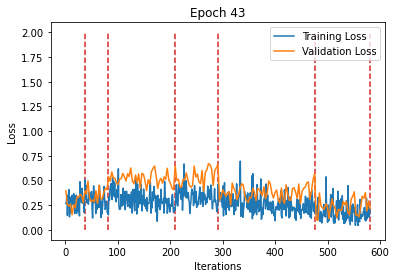

Train



Sequence:1, Seq Training Mean Loss: 0.26541780217273814, Seq Training Acc: 0.8851351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2673328167862362, Seq Training Acc: 0.8840277777777777
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.301115243864341, Seq Training Acc: 0.8629429133858267
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3184383696899181, Seq Training Acc: 0.8483231707317073
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2623603325035121, Seq Training Acc: 0.8863175675675675
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.1842562543013348, Seq Training Acc: 0.9164663461538461
******************************************************************
Epoch:44, Epoch Training Loss Mean: 0.2653505504131317, Epoch Training Acc: 0.8809806034482759
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.35078582912683487, Seq Valid Acc: 0.84375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.42653127312660216, Seq Valid Acc: 0.8041666666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.504793875274204, Seq Valid Acc: 0.7678571428571429



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.4870163989918573, Seq Valid Acc: 0.765625



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.3939297502158118, Seq Valid Acc: 0.8232581967213115



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.26179840266704557, Seq Valid Acc: 0.8928571428571429
Epoch:44, Epoch Valid Mean Loss: 0.40745002031326294, Epoch Valid Acc: 0.8152525906735751
******************************************************************


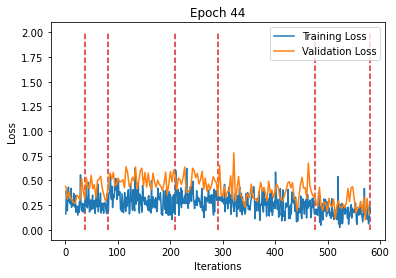

Train



Sequence:1, Seq Training Mean Loss: 0.2728748724267289, Seq Training Acc: 0.875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27776342233022056, Seq Training Acc: 0.8777777777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3165670931339264, Seq Training Acc: 0.8567913385826772
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.31241025521260934, Seq Training Acc: 0.8517530487804879
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.26118873438319645, Seq Training Acc: 0.8869932432432432
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.17391343264339063, Seq Training Acc: 0.9242788461538461
******************************************************************
Epoch:45, Epoch Training Loss Mean: 0.2669384777545929, Epoch Training Acc: 0.8806034482758621
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3808238034447034, Seq Valid Acc: 0.8177083333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.36937464475631715, Seq Valid Acc: 0.8395833333333333



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.5063237533682868, Seq Valid Acc: 0.7559523809523809



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.5563712194561958, Seq Valid Acc: 0.7354910714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.38763727931702724, Seq Valid Acc: 0.8222336065573771



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.21168144451720375, Seq Valid Acc: 0.9160714285714285
Epoch:45, Epoch Valid Mean Loss: 0.40419286489486694, Epoch Valid Acc: 0.813309585492228
******************************************************************


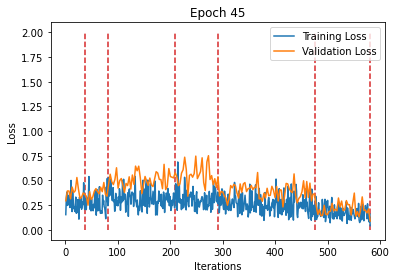

Train



Sequence:1, Seq Training Mean Loss: 0.3028542113465232, Seq Training Acc: 0.862331081081081
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.30347581737571294, Seq Training Acc: 0.8618055555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3127640633015182, Seq Training Acc: 0.8570374015748031
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.32520491720699685, Seq Training Acc: 0.8460365853658537
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.24839932568169928, Seq Training Acc: 0.8923986486486486
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.17547305057255122, Seq Training Acc: 0.9242788461538461
******************************************************************
Epoch:46, Epoch Training Loss Mean: 0.2680222988128662, Epoch Training Acc: 0.8795258620689655
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3229956241945426, Seq Valid Acc: 0.8567708333333334



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3904332141081492, Seq Valid Acc: 0.8291666666666667



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4855763649656659, Seq Valid Acc: 0.7641369047619048



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.4831394978931972, Seq Valid Acc: 0.7544642857142857



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.3892991577015548, Seq Valid Acc: 0.8299180327868853



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.22083264120987484, Seq Valid Acc: 0.9053571428571429
Epoch:46, Epoch Valid Mean Loss: 0.3892795443534851, Epoch Valid Acc: 0.8199481865284974
******************************************************************


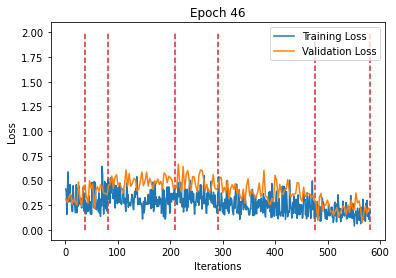

Train



Sequence:1, Seq Training Mean Loss: 0.2698589442549525, Seq Training Acc: 0.8834459459459459
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2860342433055242, Seq Training Acc: 0.8645833333333334
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3121453746566622, Seq Training Acc: 0.8609744094488189
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3344622635986747, Seq Training Acc: 0.8334603658536586
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.26183761491163354, Seq Training Acc: 0.8863175675675675
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.18528020604012105, Seq Training Acc: 0.9191706730769231
******************************************************************
Epoch:47, Epoch Training Loss Mean: 0.27178239822387695, Epoch Training Acc: 0.8773168103448276
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3318055061002572, Seq Valid Acc: 0.8697916666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3743437210718791, Seq Valid Acc: 0.8229166666666666



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.443561994603702, Seq Valid Acc: 0.796875



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.4583855154258864, Seq Valid Acc: 0.7689732142857143



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.34293060664270747, Seq Valid Acc: 0.8529713114754098



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.2298486398799079, Seq Valid Acc: 0.9133928571428571
Epoch:47, Epoch Valid Mean Loss: 0.3628222346305847, Epoch Valid Acc: 0.8382448186528497
******************************************************************


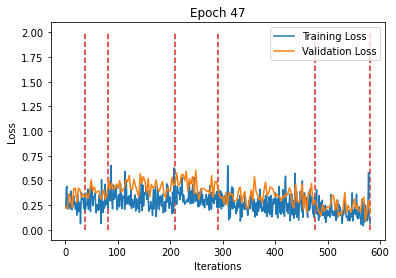

Train



Sequence:1, Seq Training Mean Loss: 0.2673482858651393, Seq Training Acc: 0.8851351351351351
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3061343322197596, Seq Training Acc: 0.8576388888888888
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.29374366236014626, Seq Training Acc: 0.8710629921259843
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.349669267309875, Seq Training Acc: 0.8338414634146342
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.2631831182418643, Seq Training Acc: 0.8800675675675675
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.18573596862216407, Seq Training Acc: 0.9194711538461539
******************************************************************
Epoch:48, Epoch Training Loss Mean: 0.27181321382522583, Epoch Training Acc: 0.8772090517241379
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.306780385474364, Seq Valid Acc: 0.8776041666666666



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.41533090472221373, Seq Valid Acc: 0.8020833333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4235549129190899, Seq Valid Acc: 0.7953869047619048



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.4155796968511173, Seq Valid Acc: 0.7991071428571429



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.31442276205195757, Seq Valid Acc: 0.8601434426229508



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.23135266155004502, Seq Valid Acc: 0.9089285714285714
Epoch:48, Epoch Valid Mean Loss: 0.34515026211738586, Epoch Valid Acc: 0.8426165803108808
******************************************************************


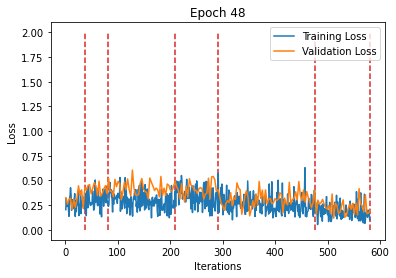

Train



Sequence:1, Seq Training Mean Loss: 0.2855927626023421, Seq Training Acc: 0.8800675675675675
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3026835964785682, Seq Training Acc: 0.8625
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.3022662782528269, Seq Training Acc: 0.858513779527559
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.33984946295982454, Seq Training Acc: 0.8285060975609756
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.25379569602979196, Seq Training Acc: 0.8890202702702703
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.18301133155966035, Seq Training Acc: 0.91796875
******************************************************************
Epoch:49, Epoch Training Loss Mean: 0.2697044014930725, Epoch Training Acc: 0.8763469827586207
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2742857461174329, Seq Valid Acc: 0.890625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4044059991836548, Seq Valid Acc: 0.83125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.38926862676938373, Seq Valid Acc: 0.8385416666666666



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.4061416121465819, Seq Valid Acc: 0.8058035714285714



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.3132421418291623, Seq Valid Acc: 0.8591188524590164



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.25427316448518206, Seq Valid Acc: 0.9053571428571429
Epoch:49, Epoch Valid Mean Loss: 0.33723366260528564, Epoch Valid Acc: 0.8550841968911918
******************************************************************


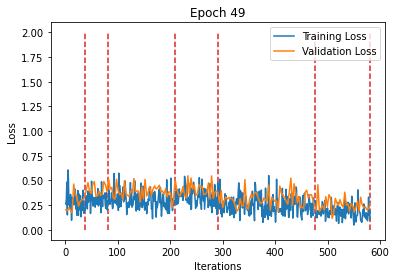

Train



Sequence:1, Seq Training Mean Loss: 0.29122162288105163, Seq Training Acc: 0.8640202702702703
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.29630458950996397, Seq Training Acc: 0.8673611111111111
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.292601960322519, Seq Training Acc: 0.8693405511811023
******************************************************************



Sequence:4, Seq Training Mean Loss: 0.3704985892627297, Seq Training Acc: 0.8197408536585366
******************************************************************



Sequence:5, Seq Training Mean Loss: 0.24515487628208624, Seq Training Acc: 0.893581081081081
******************************************************************



Sequence:6, Seq Training Mean Loss: 0.19771312098377025, Seq Training Acc: 0.9122596153846154
******************************************************************
Epoch:50, Epoch Training Loss Mean: 0.2716656029224396, Epoch Training Acc: 0.8772629310344827
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.275264460593462, Seq Valid Acc: 0.890625



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3814457376797994, Seq Valid Acc: 0.8333333333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.3585331170331864, Seq Valid Acc: 0.8616071428571429



******************************************************************
Sequence:4, Seq Valid Mean Loss: 0.39597675842898233, Seq Valid Acc: 0.8102678571428571



******************************************************************
Sequence:5, Seq Valid Mean Loss: 0.31242874069292037, Seq Valid Acc: 0.8693647540983607



******************************************************************
Sequence:6, Seq Valid Mean Loss: 0.265277755686215, Seq Valid Acc: 0.9035714285714286
Epoch:50, Epoch Valid Mean Loss: 0.3290853798389435, Epoch Valid Acc: 0.8638277202072538
******************************************************************


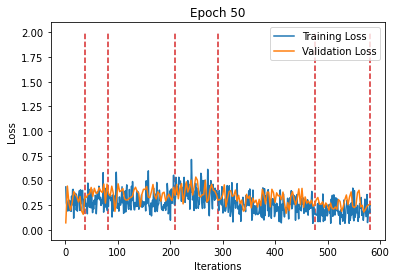


Save Model
Finished Training


In [24]:
if run_train:
    writer = SummaryWriter('runs/008_Experiment_3stripes_720x20_lr' + str(lr) + '_' + timestampStr)
    max_iter_per_seq = 600
    # 训练迭代总步数
    num_train_iter_per_epoch = 0
    num_train_iterations = [] # For plot parting line
    num_train_iterations_per_dl = [max_iter_per_seq if len(dl)>= max_iter_per_seq else len(dl) for dl in train_dls]
    for seq_dataloaders in dataloaders:
        if len(seq_dataloaders[train_dl_idx]) <= max_iter_per_seq:
            num_train_iter_per_epoch += len(seq_dataloaders[train_dl_idx])
        else:
            num_train_iter_per_epoch += max_iter_per_seq
        num_train_iterations.append(num_train_iter_per_epoch)
    print("Total Train Iterations: ",num_train_iter_per_epoch)
    print("Total Train Iterations List: ",num_train_iterations)
        
    # 训练迭代总步数为验证迭代总步数的3倍
    num_val_iterations = [int(number / 3) for number in num_train_iterations]
    num_val_iter_per_epoch = num_val_iterations[-1]
    
    # iterations in every seq
    num_val_iter_per_seq = []
    num_val_iter_per_seq.append(num_val_iterations[0])
    for i in range(len(num_val_iterations)-1):
        diff = num_val_iterations[i+1] - num_val_iterations[i] # The latter minus the former
        num_val_iter_per_seq.append(diff)
        
    print("Valid iterations per seq: ",num_val_iter_per_seq)
        
    optimizer = torch.optim.Adam(model.parameters(),lr=lr,eps=1e-08)

    scheduler = OneCycleLR(optimizer, num_train_iter_per_epoch, num_epochs, min_lr_factor=min_lr_factor)
    scheduler.step(epoch=0)
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.
    loss_min = 0.
    
    for epoch in tqdm(range(1,num_epochs+1)):

        print('Train')

        model.train()
        
        running_corrects = 0

        train_loss_array = np.zeros(num_train_iter_per_epoch, dtype=np.single)

        # mse_y = torch.zeros(batch_sizes[0]//2).to(device)
        
        i = 0
        seq_idx = 1
        for (refs, train_dl, max_num) in zip(refs_list, train_dls, num_train_iterations_per_dl):
            # obtain the refs in every seq
            
            curr_train_dl = train_dl

            curr_refs = refs.float().to(device)

            # Training
            dl_iter = iter(curr_train_dl)
            
            # This two only used to compute the loss and acc in every Sequence
            running_loss = 0
            corrects = 0
            for idx in tqdm(range(max_num)):
                if idx >= max_iter_per_seq:
                    break
                try:
                    img1, img2, targets = next(dl_iter)

                except (StopIteration, TypeError):
                    dl_iter = iter(curr_train_dl)
                    img1, img2, targets = next(dl_iter)
                
                scheduler.zero_grad()

                img1 = img1.float().to(device)
                img2 = img2.float().to(device)
                targets = targets.view(-1)
                targets = targets.float().to(device)

                # forward pass
                loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                
                loss.backward()
                
                running_loss += loss.item()
                corrects += torch.sum(preds == targets)
                running_corrects += torch.sum(preds == targets)

                train_loss_array[i] = loss.cpu().detach().numpy()
               
                
                # record loss and accuracy per iteration
                c = torch.sum(preds == targets)
                acc = int(c) / img1.size(0)
                writer.add_scalar('Train/Loss per Iteration',train_loss_array[i], ((epoch - 1) * num_train_iter_per_epoch)+ i)
                writer.add_scalar('Train/Acc per Iteration',acc, ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                # Record the lr
                curr_lr = get_lr(optimizer)
                writer.add_scalar('Train/Learning Rate',curr_lr , ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                i += 1
                scheduler.step()
            
            # record loss and accuracy in every train dataloader (namely every Sequence)
            #seq_train_mean_loss = running_loss / len(curr_train_dl)
            #seq_train_acc = int(corrects) / (len(curr_train_dl) * img1.size(0))
            seq_train_mean_loss = running_loss / max_num
            seq_train_acc = int(corrects) / (max_num * img1.size(0))
            
            print("Sequence:{}, Seq Training Mean Loss: {}, Seq Training Acc: {}".format(seq_idx, seq_train_mean_loss, seq_train_acc))
            print("******************************************************************")
            # Record the loss and acc in every Seq in Tensorboard
            writer.add_scalar('Train/Seq Training Mean Loss',seq_train_mean_loss, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Training Accuracy', seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Error Rate',1 - seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            
            seq_idx += 1
            
        # after one epoch update scheduler   
        # Plot lr policy
        curr_lr = get_lr(optimizer)
        writer.add_scalar('Train/Learning Rate Policy',curr_lr , epoch)
        writer.flush()
            
        # record loss and accuracy in every epoch (namely 6 Sequences)
        epoch_train_mean_loss = train_loss_array.mean()  # std
        epoch_train_acc = int(running_corrects) / (num_train_iter_per_epoch * img1.size(0))

        print("Epoch:{}, Epoch Training Loss Mean: {}, Epoch Training Acc: {}".format(epoch, epoch_train_mean_loss, epoch_train_acc))
        print("******************************************************************")
        
        ### Validation
        print('Validation')
        model.eval()
        val_loss_array = np.zeros(num_val_iter_per_epoch, dtype=np.single)
        
        running_corrects = 0

        i = 0
        with torch.no_grad():
            seq_idx = 1
            for (refs, valid_dl, max_num) in zip(refs_list,valid_dls, num_val_iter_per_seq):
                
                curr_valid_dl = valid_dl
                curr_refs = refs.float().to(device)
                iter_max_num = max_num
            
                dl_iter = iter(curr_valid_dl)
                # This two uesd to compute loss and accurary in every Seq
                running_loss = 0
                corrects = 0
                for dl_idx in tqdm(range(iter_max_num)):
                    try:
                        img1, img2, targets = next(dl_iter)
                    except (StopIteration, TypeError):
                        dl_iter = iter(curr_valid_dl)
                        img1, img2, targets = next(dl_iter)

                    img1 = img1.float().to(device)
                    img2 = img2.float().to(device)
                    targets = targets.view(-1)
                    targets = targets.float().to(device)
                
                    loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
                    running_loss += loss.item()
                    corrects += torch.sum(preds == targets)
                    running_corrects += torch.sum(preds == targets)
                    
                    # record loss and accuracy in every iteration
                    c = torch.sum(preds == targets)
                    acc = int(c) / img1.size(0)
                    writer.add_scalar('Validation/Loss per Iteration',loss.item(), ((epoch - 1) * num_val_iter_per_epoch)+ i)
                    writer.add_scalar('Validation/Acc per Iteration',acc, ((epoch - 1) * num_val_iter_per_epoch)+ i)

                    val_loss_array[i] = loss.cpu().detach().numpy()
                    i += 1
            
                #seq_val_mean_loss = running_loss / len(curr_valid_dl)
                #seq_val_acc = int(corrects) / (len(curr_valid_dl) * img1.size(0))
                seq_val_mean_loss = running_loss / iter_max_num
                seq_val_acc = int(corrects) / (iter_max_num * img1.size(0))
                print("******************************************************************")
                print("Sequence:{}, Seq Valid Mean Loss: {}, Seq Valid Acc: {}".format(seq_idx,seq_val_mean_loss, seq_val_acc))
                
                writer.add_scalar('Validation/Seq Mean Loss',seq_val_mean_loss, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Accuracy', seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Error Rate',1 - seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                
                seq_idx += 1
                
            epoch_val_mean_loss = val_loss_array.mean()  # std
            epoch_val_acc = int(running_corrects) / (num_val_iter_per_epoch * img1.size(0))

            print("Epoch:{}, Epoch Valid Mean Loss: {}, Epoch Valid Acc: {}".format(epoch, epoch_val_mean_loss, epoch_val_acc))
            print("******************************************************************")
            
        # save best model weights
        if epoch_val_acc > best_acc:
            best_model_wts = copy.deepcopy(model.state_dict())
            loss_min = epoch_val_mean_loss
            
        # Tensorboard
        writer.add_scalars('Epoch/Loss', {"Training Loss": epoch_train_mean_loss,
                                          "Validation Loss": epoch_val_mean_loss}, epoch)
        writer.add_scalars('Epoch/Accuracy', {"Training Accuracy":epoch_train_acc,
                                              "Validation Accuracy": epoch_val_acc}, epoch)
        writer.add_scalars('Epoch/Error Rate', {"Training": 1 - epoch_train_acc,
                                                "Validation": 1 - epoch_val_acc}, epoch)
        writer.flush()
        
        plt.plot(np.linspace(1, train_loss_array.size+1, train_loss_array.size), train_loss_array,label='Training Loss')
        plt.plot(np.linspace(1, train_loss_array.size+1, val_loss_array.size), val_loss_array, label='Validation Loss')
        
        train_parting_line = num_train_iterations  # 1128 iterations in total in training
        val_parting_line = num_val_iterations  # 373 iterations in total in validation
        plt.vlines(train_parting_line, 0, 2, colors = "tab:red", linestyles = "dashed")
        
        plt.title('Epoch {}'.format(epoch))
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
    print("Save Model")
    torch.save(model, net_path + '/m-' + timestampStr)
    torch.save({'epoch': epoch, 
                'state_dict': best_model_wts, 
                'best_loss': loss_min,
                'optimizer': optimizer.state_dict()},
                net_path + '/m-' + timestampStr + '-' + str("%.4f" % loss_min) + '.pth.tar')
    # add model to tensorboard
    #writer.add_graph(model,(img1, curr_refs, targets))
    writer.flush()

    print('Finished Training')
        

### Test Config

In [25]:
batch_size = 32
valid_dl_idx = 1
num_test_iter_per_epoch = 0
for seq_dataloaders in dataloaders:
    num_test_iter_per_epoch += len(seq_dataloaders[2])
    
model.eval()
y_vect = np.zeros(batch_size * num_test_iter_per_epoch)
y_tilde_vect = np.zeros(batch_size * num_test_iter_per_epoch)

i = 0
with torch.no_grad():
    seq_idx = 1
    
    running_corrects = 0

    test_loss_array = np.zeros(num_test_iter_per_epoch, dtype=np.single)
    
    for (refs, test_dl) in zip(refs_list,valid_dls):
        
        curr_test_dl = test_dl
        
        curr_refs = refs.float().to(device) 

        dl_iter = iter(curr_test_dl)
        
        # This two uesd to compute loss and accurary in every Seq
        running_loss = 0
        corrects = 0

        for dl_idx in tqdm(range(len(curr_test_dl))):
            try:
                img1, img2, targets = next(dl_iter)
            except (StopIteration, TypeError):
                dl_iter = iter(curr_valid_dl)
                img1, img2, targets = next(dl_iter)

            scheduler.zero_grad()
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)
            targets = targets.view(-1)
            targets = targets.float().to(device)
              
            loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
            running_loss += loss.item()
            corrects += torch.sum(preds == targets)
            
            test_loss_array[i] = loss.cpu().detach().numpy()

            y_vect[i*batch_size:(i+1)*batch_size] = targets.detach().cpu().numpy()
            y_tilde_vect[i*batch_size:(i+1)*batch_size] = preds.detach().cpu().numpy()
            
            # record loss and accuracy per iteration
            c = torch.sum(preds == targets)
            acc = int(c) / img1.size(0)
            
            writer.add_scalar('Test/Loss per Iteration',test_loss_array[i], i)
            writer.add_scalar('Test/Acc per Iteration',acc, i)
            writer.add_scalar('Test/Error Rate', 1 - acc, i)

            i += 1
        # record seq test loss and acc
        seq_test_mean_loss = running_loss / len(curr_test_dl)
        seq_test_acc = int(corrects) / (len(curr_test_dl) * img1.size(0))
        
        print("******************************************************************")
        print("Test: Sequence:{}, Seq Mean Loss: {}, Seq Acc: {}".format(seq_idx,seq_test_mean_loss, seq_test_acc))
            
        writer.add_scalar('Test/Seq Loss', seq_test_mean_loss, seq_idx)
        writer.add_scalar('Test/Seq Accuracy', seq_test_acc, seq_idx)
        writer.add_scalar('Test/Seq Error Rate', 1 - seq_test_acc, seq_idx)
        
        seq_idx += 1

writer.close()
                                      
print("Test finished")


******************************************************************
Test: Sequence:1, Seq Mean Loss: 0.3104980339606603, Seq Acc: 0.859375



******************************************************************
Test: Sequence:2, Seq Mean Loss: 0.4314638654390971, Seq Acc: 0.7854166666666667



******************************************************************
Test: Sequence:3, Seq Mean Loss: 0.3675529183376403, Seq Acc: 0.8407738095238095



******************************************************************
Test: Sequence:4, Seq Mean Loss: 0.3894679469090921, Seq Acc: 0.8125



******************************************************************
Test: Sequence:5, Seq Mean Loss: 0.297885673700786, Seq Acc: 0.8719262295081968



******************************************************************
Test: Sequence:6, Seq Mean Loss: 0.2702781750875361, Seq Acc: 0.8988970588235294
Test finished


### Init test dataset for plotting degradation metrics 

In [11]:
def init_test_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []

    img_transforms = [#RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5ForTest(h5_fpath, normalize_im=False, transform = composed_img_transforms)
        
        # obtain the references, the first 32 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [12]:
# 3 stripes
data_path_type2 = "../data/22008_1000202026_652510007"
fnames_type2 = "roi_versuch2_1_{}_720x20.h5" # 2,3,4
combined_path_type2 = os.path.join(data_path_type2, fnames_type2)
seq_idx_list_type2 = [0,1,2,3,4,5]

In [13]:
mean_val = 124.8660
std_val = 67.9694
refs_list, ds_h5_test = init_test_dataset(combined_path_type2, seq_idx_list_type2, mean_val, std_val)

In [14]:
ds_h5_test

#### init dataloader

In [31]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

### Degradation metrics function

In [32]:
def degradation_metrics(v1, refs_tensor):
    r"""Calculate distance between vector of img1&img2 and each reference images
    Args:
        v1 (Tensor, torch.Size[batchsize,128]): batch of imgs from feature extractor
        
        refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
    """
    v_dim = v1.size(1) # 128
    num_ref = refs_tensor.size(0)

    v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
    refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size
    
    kernel_matrix1 = (v11-refs).pow(2).sum(2) 
    
    metric = torch.mean(kernel_matrix1,dim = 1) 

    return metric

In [33]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('ResNet34_3stripes_720x20_0-5_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

1991



2449



6819



4424



9911



5576


<IPython.core.display.Javascript object>


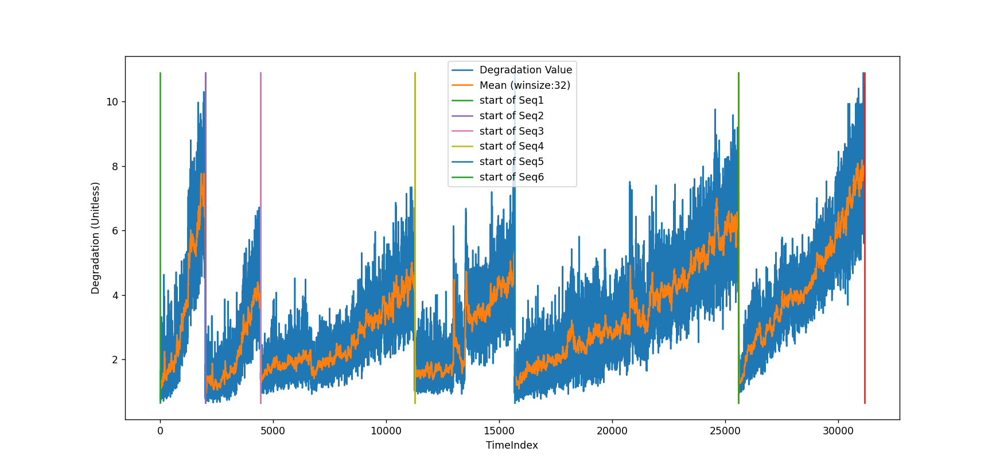

In [34]:
%matplotlib notebook
plt.plot(all_seq_y_tilde_vect, label='Degradation Value')
plt.plot(pd.Series(all_seq_y_tilde_vect).rolling(32).mean(), label='Mean (winsize:32)')

min_y = all_seq_y_tilde_vect.min()
max_y = all_seq_y_tilde_vect.max()


# 3 stripes Data
seq_period_iloc = [
    [    0,  1991],
    [ 1991,  4440],
    [ 4440,  11259],
    [ 11259, 15683],
    [ 15683, 25594],
    [ 25594, 31170],
]

seq_index = 1
for stime_iloc, etime_iloc in seq_period_iloc:
    plt.plot([stime_iloc, stime_iloc], [min_y, max_y], label = "start of Seq{}".format(seq_index))
    plt.plot([etime_iloc, etime_iloc], [min_y, max_y])
    seq_index += 1


plt.ylabel("Degradation (Unitless)")
plt.xlabel("TimeIndex")

plt.legend()
plt.show()

In [35]:
import plotly.graph_objects as go

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        name = 'Degradation Metric',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        name = 'Mean(Windowsize:32)',
        #mode='lines+markers',
    )
)

In [36]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

## To see the intmediate feature

In [ ]:
feature_output1 = model.feature_extractor.featuremap1.transpose(1,0).cpu()
feature_output2 = model.feature_extractor.featuremap2.transpose(1,0).cpu()
feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
#feature_output4 = model.model.featuremap4.transpose(1,0).cpu()
#feature_output_fc = model.model.featuremapfc.transpose(1,0).cpu()
feature_output3.shape

In [47]:
def feature_imshow(inp, title=None):
    
    """Imshow for Tensor."""
    
    inp = inp.detach().numpy().transpose((2, 1, 0))
    
    mean = np.array([0.5, 0.5, 0.5])
    
    std = np.array([0.5, 0.5, 0.5])
    
    inp = std * inp + mean
    
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(5,5))
    plt.imshow(inp)
    
    if title is not None:
        plt.title(title)
    
    plt.pause(0.001)  # pause a bit so that plots are updated

In [60]:
dl = test_dataloaders[3]
refs = refs_list[3]

curr_refs = refs.float().to(device)
num_data = len(dl)
print(num_data)
    
loss_vect = np.zeros(num_data)
var_res_vect= np.zeros(num_data)

y_vect = np.zeros(num_data)
y_tilde_vect = np.zeros(num_data)

dl_iter = iter(dl)

for i in tqdm(range(2269)):
    try:
        img,label = next(dl_iter)

    except (StopIteration, TypeError):
        dl_iter = iter(curr_train_dl)
        img,label = next(dl_iter)

    y_vect[i] = label

    img = img.float().to(device)
    
    #feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
    
    latent_vector = model.featuremap(img)
    refs_latent_vectors = model.featuremap_refs(curr_refs)
    
    output1 = latent_vector.transpose(1,0).cpu()
    output_refs = refs_latent_vectors.transpose(1,0).cpu()

4424


<IPython.core.display.Javascript object>


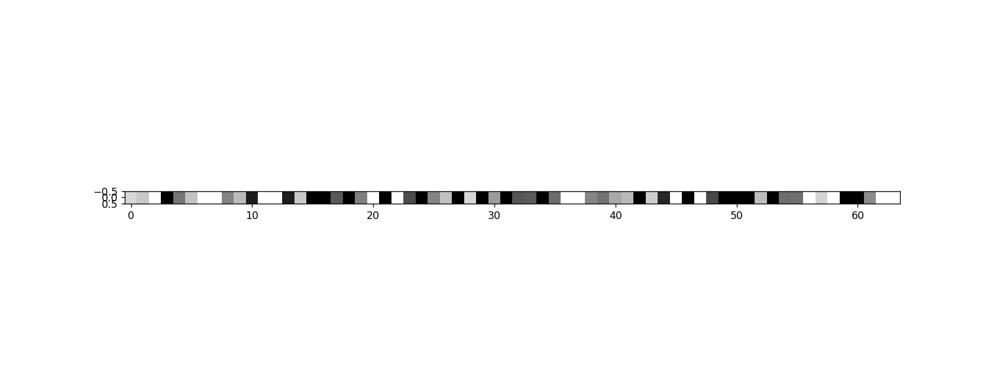

In [59]:
out = torchvision.utils.make_grid(output1)
feature_imshow(out)

<IPython.core.display.Javascript object>


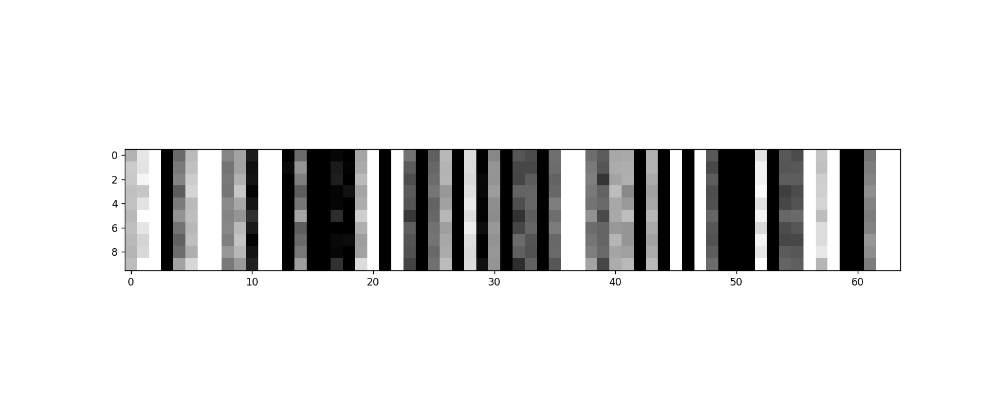

In [62]:
out = torchvision.utils.make_grid(output_refs)
feature_imshow(out)

# Load Model und Test

In [7]:
m_path = 'save_net/m-22-May-2021 (21:34:20)-0.3291.pth.tar'
lr_val = 1e-4
res_model = models.resnet34(pretrained=True)
feature_extractor = FeatureExtractor(res_model)
model = RefBasedDeepMetric(feature_extractor,loss_non_linearity_name='sigmoid',criterion_name='bce',)
optimizer = torch.optim.Adam(model.parameters(),lr=lr_val, eps=1e-08, weight_decay=0)

In [8]:
def load_model(model, m_path, optimizer):
    model_CKPT = torch.load(m_path)
    model.load_state_dict(model_CKPT['state_dict'])
    print('loading checkpoint!')
    optimizer.load_state_dict(model_CKPT['optimizer'])
    return model, optimizer

In [9]:
model, optimizer = load_model(model,m_path, optimizer)

loading checkpoint!


In [10]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

RefBasedDeepMetric(
  (feature_extractor): FeatureExtractor(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, aff

In [15]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

In [16]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('ResNet34_3stripes_720x20_0-5_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

1991



2449



6819



4424



9911



5576


In [17]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

# Find Outliers

In [18]:
all_seq_y_tilde_vect.size

31170

In [19]:
mov_aver = pd.Series(all_seq_y_tilde_vect).rolling(32, min_periods=1).mean()
rel_outlier_idx = np.abs(all_seq_y_tilde_vect - mov_aver) > 3

In [20]:
res = all_seq_y_tilde_vect - mov_aver

In [21]:
y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean()
y_firstpart = pd.Series(all_seq_y_tilde_vect[:32]).rolling(32).mean()

In [22]:
import plotly.offline as pyo
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=res,
            mode='lines',
            name='Subtract the mean',
            #mode='lines+markers',
    )



trace1 = go.Scatter(
            x= np.arange(all_seq_y_tilde_vect.size),
            y= np.linspace(3, 3,all_seq_y_tilde_vect.size),
            mode='lines',
            name = 'Threshold',
            #mode='lines+markers',
            )

trace2 = go.Scatter(
            x= np.arange(all_seq_y_tilde_vect.size),
            y= np.linspace(-3,-3,all_seq_y_tilde_vect.size),
            mode='lines',
            name = 'Threshold',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1,trace2]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')